In [1]:
from datetime import datetime

import fcts_p5 as fct
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import prince
import seaborn as sns
from scipy import stats
from scipy.cluster.hierarchy import dendrogram
from scipy.stats import chi2_contingency
from sklearn import manifold
from sklearn.cluster import (
    DBSCAN,
    AgglomerativeClustering,
    KMeans,
    MeanShift,
    estimate_bandwidth,
)
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

In [2]:
from kmodes.kprototypes import KPrototypes

In [50]:
def display_factorial_planes(
    X_projected, n_comp, pca, axis_ranks, labels=None, alpha=1, illustrative_var=None
):
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            fig = plt.figure(figsize=(7, 6))

            # affichage des points
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1], X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(
                        X_projected[selected, d1],
                        X_projected[selected, d2],
                        alpha=alpha,
                        label=value,
                    )
                plt.legend()

            # affichage des labels des points
            if labels is not None:
                for i, (x, y) in enumerate(X_projected[:, [d1, d2]]):
                    plt.text(x, y, labels[i], fontsize="14", ha="center", va="center")

            # détermination des limites du graphique
            boundary = np.max(np.abs(X_projected[:, [d1, d2]])) * 1.1
            plt.xlim([-boundary, boundary])
            plt.ylim([-boundary, boundary])

            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-100, 100], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title(
                "Projection des individus (sur F{} et F{})".format(d1 + 1, d2 + 1)
            )
            plt.show(block=False)


def display_circles(
    pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None
):
    for (
        d1,
        d2,
    ) in (
        axis_ranks
    ):  # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7, 7))

            # détermination des limites du graphique
            if lims is not None:
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30:
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else:
                xmin, xmax, ymin, ymax = (
                    min(pcs[d1, :]),
                    max(pcs[d1, :]),
                    min(pcs[d2, :]),
                    max(pcs[d2, :]),
                )

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30:
                plt.quiver(
                    np.zeros(pcs.shape[1]),
                    np.zeros(pcs.shape[1]),
                    pcs[d1, :],
                    pcs[d2, :],
                    angles="xy",
                    scale_units="xy",
                    scale=1,
                    color="grey",
                )
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0, 0], [x, y]] for x, y in pcs[[d1, d2]].T]
                ax.add_collection(
                    LineCollection(lines, axes=ax, alpha=0.1, color="black")
                )

            # affichage des noms des variables
            if labels is not None:
                for i, (x, y) in enumerate(pcs[[d1, d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax:
                        plt.text(
                            x,
                            y,
                            labels[i],
                            fontsize="14",
                            ha="center",
                            va="center",
                            rotation=label_rotation,
                            color="blue",
                            alpha=0.5,
                        )

            # affichage du cercle
            circle = plt.Circle((0, 0), 1, facecolor="none", edgecolor="b")
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-1, 1], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title("Cercle des corrélations (F{} et F{})".format(d1 + 1, d2 + 1))
            plt.show(block=False)

In [2]:
df_ = pd.read_csv("Dataset_joined.csv")

In [3]:
df_.order_purchase_timestamp = df_.order_purchase_timestamp.apply(
    lambda x: datetime.strptime(x, "%Y-%m-%d %H:%M:%S")
)

In [367]:
df_.head(3)

,order_id,customer_unique_id,cat_mode_order,total_weight_order,volume_totat_order_cm3,price,pourcentage_livraison,nb_article,heure_commande,temps_commande_reception,order_purchase_timestamp,nombre_review_commande,review_score,semaine_vs_weekend,cat_creneautravailoupas,Distance_cust_seller_km,geolocation_lat_sellers,geolocation_lng_sellers,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,7c396fd4830fd04220f754e42b4e5bff,consommable,500.0,1976.0,29.99,0.225265,1,10,8.0,2017-10-02 10:56:33,1.0,4.0,jour_travail,temps_prof,0.000000,-23.155308,-47.084074,Est
1,53cdb2fc8bc7dce0b6741e2150273451,af07308b275d755c9edb36a90c618231,consommable,400.0,4693.0,118.70,0.160894,1,20,13.0,2018-07-24 20:41:37,1.0,4.0,jour_travail,temps_perso,1375.789636,-13.049361,-39.560649,Nord_Est
2,47770eb9100c2d0c44946d9cf07ec65d,3a653a41f6f9fc3d2a113cf8398680e8,service_outils,420.0,9576.0,159.90,0.107302,1,8,9.0,2018-08-08 08:38:49,1.0,5.0,jour_travail,temps_perso,768.269422,-16.577645,-49.334195,Ouest


In [6]:
df_.cat_mode_order.unique()

array(['consommable', 'service_outils', 'multimedia', 'vetement',
       'maison'], dtype=object)

In [7]:
fct.desc_df(df_)

Dans la base de données  on a 95104 lignes avec 19 variables. Elle est remplie à 100.0 % et il y a 0 lignes dupliquées


In [8]:
df_.nb_article.value_counts()

1     85571
2      7312
3      1292
4       491
5       191
6       189
7        22
10        8
8         8
12        5
11        4
9         3
14        2
15        2
20        2
13        1
21        1
Name: nb_article, dtype: int64

### RFM 

In [9]:
df_rfm = df_.groupby("customer_unique_id").agg(
    {"order_id": "count", "price": "sum", "order_purchase_timestamp": "max"}
)

In [383]:
df_rfm.shape

(92057, 7)

In [10]:
df_rfm.order_purchase_timestamp = df_rfm.order_purchase_timestamp.apply(
    lambda x: (df_rfm.order_purchase_timestamp.max() - x).days
)

In [11]:
df_rfm.rename(
    {
        "order_id": "Frequency",
        "price": "Monetary",
        "order_purchase_timestamp": "Recency",
    },
    axis=1,
    inplace=True,
)

In [12]:
df_rfm.Frequency.value_counts()

1     89316
2      2520
3       175
4        29
5         9
6         3
7         3
9         1
14        1
Name: Frequency, dtype: int64

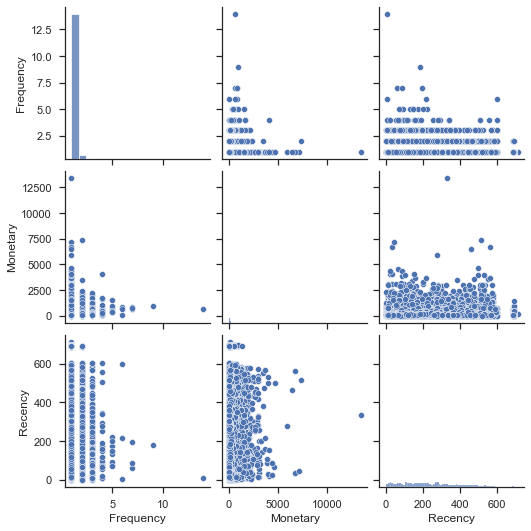

In [13]:
sns.set_theme(style="ticks")

sns.pairplot(df_rfm)

In [14]:
df_rfm.describe()

,Frequency,Monetary,Recency
count,92057.000000,92057.000000,92057.000000
mean,1.033099,141.705918,236.222145
std,0.206886,215.531470,152.545896
min,1.000000,0.850000,0.000000
25%,1.000000,47.800000,113.000000
50%,1.000000,89.590000,217.000000
75%,1.000000,154.900000,345.000000
max,14.000000,13440.000000,713.000000


C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0.98, 'Analyse univariée: Représentation Moneatry')

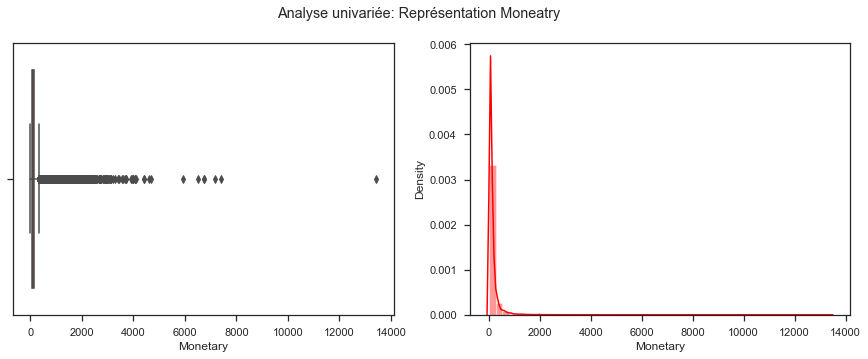

In [15]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
sns.boxplot(df_rfm.Monetary, ax=ax[0], color="red")
sns.distplot(df_rfm.Monetary, ax=ax[1], color="red")
plt.suptitle("Analyse univariée: Représentation Moneatry")

In [16]:
xt, _ = stats.boxcox(df_rfm.Monetary)

In [17]:
df_rfm["boxcox_Monetary"] = xt

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0.98, 'Analyse univariée: Représentation boxcox Moneatry')

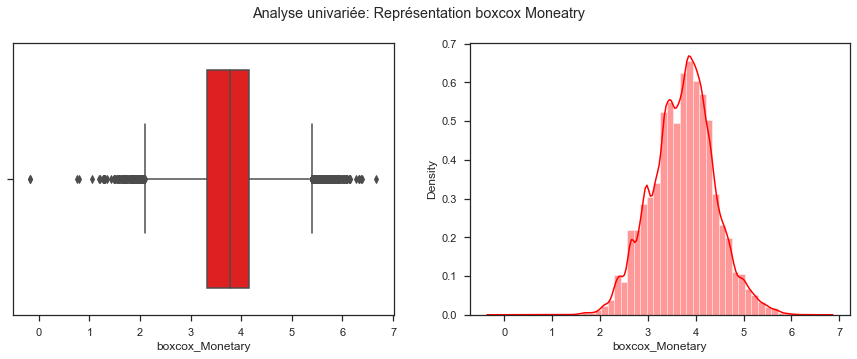

In [18]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
sns.boxplot(df_rfm.boxcox_Monetary, ax=ax[0], color="red")
sns.distplot(df_rfm.boxcox_Monetary, ax=ax[1], color="red")
plt.suptitle("Analyse univariée: Représentation boxcox Moneatry")

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0.98, 'Analyse univariée: Représentation Recency')

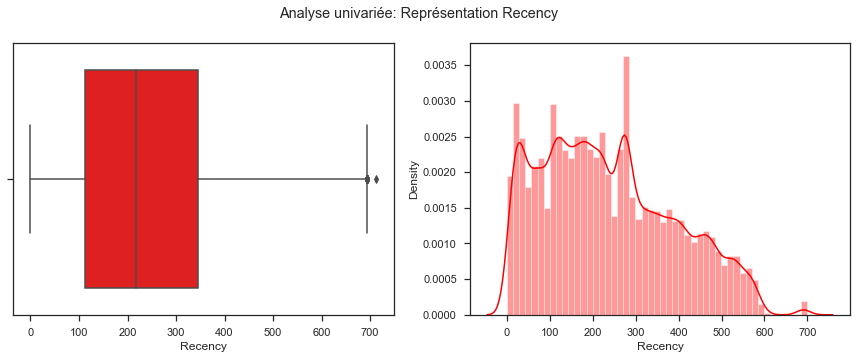

In [19]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
sns.boxplot(df_rfm.Recency, ax=ax[0], color="red")
sns.distplot(df_rfm.Recency, ax=ax[1], color="red")
plt.suptitle("Analyse univariée: Représentation Recency")

In [20]:
df_rfm.Recency = df_rfm.Recency + 1

In [21]:
xtr, _ = stats.boxcox(df_rfm.Recency)

In [22]:
df_rfm["boxcoxRecency"] = xtr

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 0.98, 'Analyse univariée: Représentation boxcox Recency')

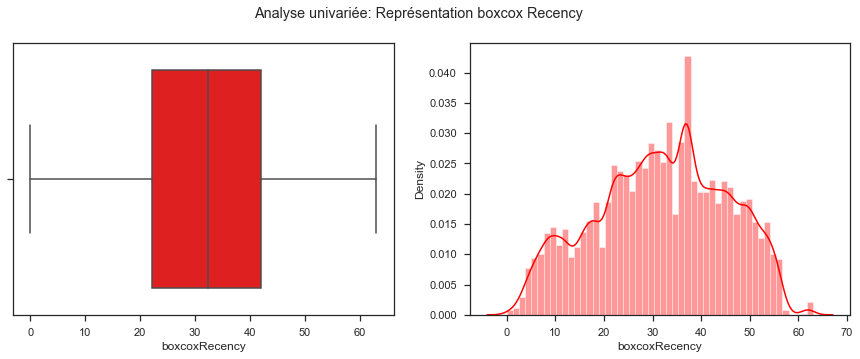

In [23]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
sns.boxplot(df_rfm.boxcoxRecency, ax=ax[0], color="red")
sns.distplot(df_rfm.boxcoxRecency, ax=ax[1], color="red")
plt.suptitle("Analyse univariée: Représentation boxcox Recency")

In [24]:
df_rfm["Frequency_1vspls"] = df_rfm.Frequency.apply(lambda x: x if x == 1 else 2)

In [25]:
df_rfm.columns

Index(['Frequency', 'Monetary', 'Recency', 'boxcox_Monetary', 'boxcoxRecency',
       'Frequency_1vspls'],
      dtype='object')

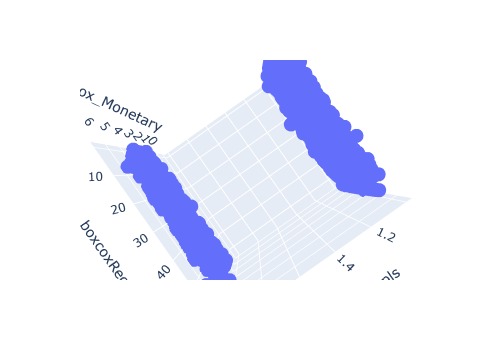

In [26]:
fig = px.scatter_3d(
    df_rfm, x="Frequency_1vspls", y="boxcoxRecency", z="boxcox_Monetary"
)
fig.show()

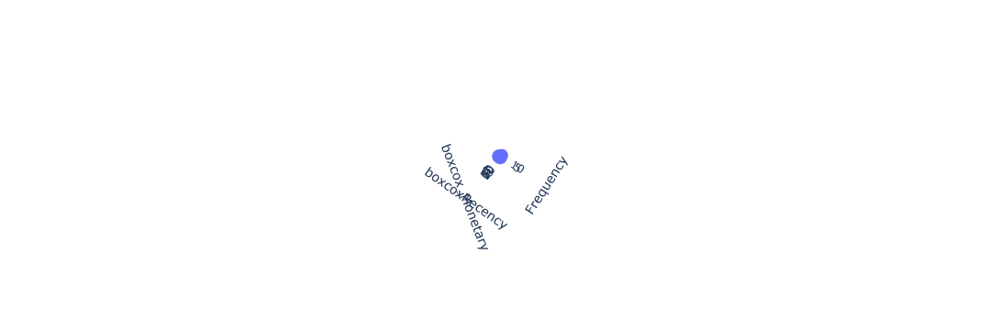

In [27]:
fig = px.scatter_3d(df_rfm, x="Frequency", y="boxcoxRecency", z="boxcox_Monetary")
fig.show()

In [28]:
scaler = MinMaxScaler(feature_range=(1, 100))
rfm = pd.DataFrame(
    scaler.fit_transform(
        df_rfm[["Frequency_1vspls", "boxcoxRecency", "boxcox_Monetary"]]
    ),
    columns=["F", "R", "M"],
    index=df_rfm.index,
)

Après avoir standardiser entre 1 et 100 on peut avoir un score en suivant ce calcul:


<font color='red'>  0,15.Recency score + 0,28.Frequency score + 0,57.Monetary score

In [29]:
score_rfm = rfm.apply(lambda x: (x.F * 0.28 + 0.15 * x.R + 0.57 * x.M) * 0.05, axis=1)

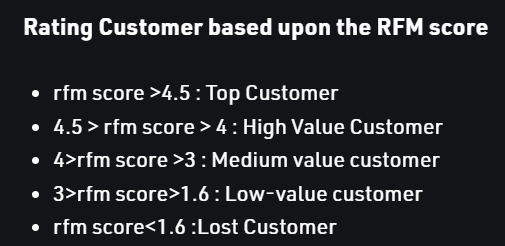

In [30]:
score_rfm.describe()

count    92057.000000
mean         2.074730
std          0.411606
min          0.328185
25%          1.827547
50%          2.043754
75%          2.257228
max          4.757248
dtype: float64

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:ylabel='Density'>

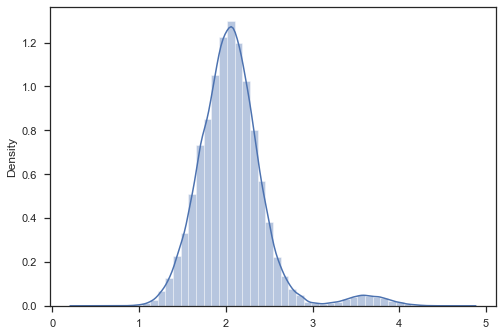

In [31]:
sns.distplot(score_rfm)

In [32]:
def customer_is(x):
    if x > 4.5:
        return "Top Customer"
    elif x > 4:
        return "High Value Customer"
    elif x > 3:
        return "Medium Value Customer"
    elif x > 1.6:
        return "Low-value Customer"
    else:
        return "Lost Customer"

In [33]:
df_rfm["score"] = score_rfm.apply(customer_is)

In [34]:
df_rfm.score.value_counts()

Low-value Customer       81425
Lost Customer             7813
Medium Value Customer     2631
High Value Customer        186
Top Customer                 2
Name: score, dtype: int64

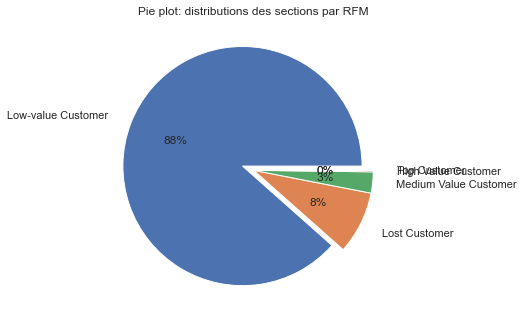

In [35]:
plt.pie(
    df_rfm.score.value_counts(),
    labels=df_rfm.score.value_counts().index,
    autopct="%.0f%%",
    labeldistance=1.2,
    explode=(0.1, 0, 0, 0, 0),
)
plt.title("Pie plot: distributions des sections par RFM")
plt.show()

In [36]:
df_rfm.head(3)

,Frequency,Monetary,Recency,boxcox_Monetary,boxcoxRecency,Frequency_1vspls,score
customer_unique_id,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,129.9,112,4.035222,21.938174,1,Low-value Customer
0000b849f77a49e4a4ce2b2a4ca5be3f,1,18.9,115,2.620794,22.281181,1,Lost Customer
0000f46a3911fa3c0805444483337064,1,69.0,537,3.594688,53.750491,1,Low-value Customer


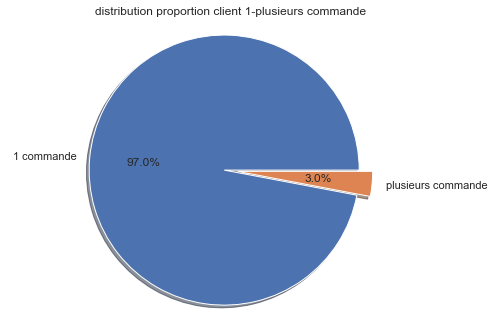

In [400]:
sizes = df_rfm.Frequency_1vspls.value_counts().values
explode = (0, 0.1)  # only "explode" the 2nd slice (i.e. 'Hogs')
fig1, ax1 = plt.subplots()
fig1.patch.set_facecolor(color="white")

ax1.pie(
    sizes,
    explode=explode,
    labels=["1 commande", "plusieurs commande"],
    autopct="%1.1f%%",
    shadow=True,
)
ax1.axis("equal")  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title("distribution proportion client 1-plusieurs commande")
plt.show()

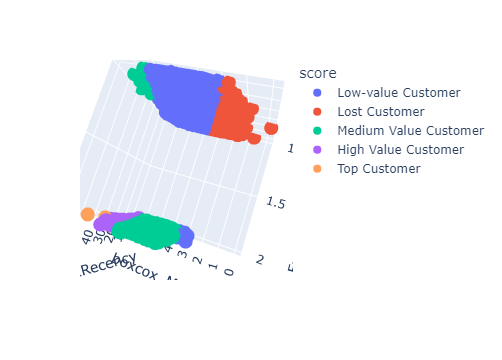

In [37]:
fig = px.scatter_3d(
    df_rfm, x="Frequency_1vspls", y="boxcoxRecency", z="boxcox_Monetary", color="score"
)
fig.show()

In [135]:
df_rfm[["Frequency", "score"]].groupby("score").describe()

Frequency                                              
                          count      mean       std  min  25%  50%  75%   max
score                                                                        
High Value Customer       186.0  2.263441  0.825576  2.0  2.0  2.0  2.0   9.0
Lost Customer            7813.0  1.000000  0.000000  1.0  1.0  1.0  1.0   1.0
Low-value Customer      81425.0  1.000295  0.017867  1.0  1.0  1.0  1.0   3.0
Medium Value Customer    2631.0  2.058913  0.493250  1.0  2.0  2.0  2.0  14.0
Top Customer                2.0  2.000000  0.000000  2.0  2.0  2.0  2.0   2.0

In [136]:
df_rfm[["Recency", "score"]].groupby("score").describe()

Recency                                                \
                         count        mean         std    min     25%    50%   
score                                                                          
High Value Customer      186.0  356.274194  124.003945   22.0  268.00  364.5   
Lost Customer           7813.0  106.379240   96.325243    1.0   29.00   78.0   
Low-value Customer     81425.0  249.997912  151.102952    1.0  128.00  232.0   
Medium Value Customer   2631.0  221.806157  147.666698    1.0  104.00  197.0   
Top Customer               2.0  449.500000   92.630988  384.0  416.75  449.5   

                                      
                          75%    max  
score                                 
High Value Customer    448.75  690.0  
Lost Customer          158.00  689.0  
Low-value Customer     359.00  714.0  
Medium Value Customer  317.50  694.0  
Top Customer           482.25  515.0

In [137]:
df_rfm[["Monetary", "score"]].groupby("score").describe()

Monetary                                              \
                         count         mean          std      min      25%   
score                                                                        
High Value Customer      186.0   795.274570   494.751528   243.79   468.00   
Lost Customer           7813.0    23.560668    10.930688     0.85    14.90   
Low-value Customer     81425.0   146.316692   197.595123     8.90    54.85   
Medium Value Customer   2631.0   299.634177   527.443953    20.70   113.98   
Top Customer               2.0  5423.500000  2778.222543  3459.00  4441.25   

                                                    
                            50%       75%      max  
score                                               
High Value Customer     650.945   974.265   4080.0  
Lost Customer            20.000    29.900     65.0  
Low-value Customer       95.200   159.900   7160.0  
Medium Value Customer   179.800   293.750  13440.0  
Top Customer           5423.500  6405.750   7388.0

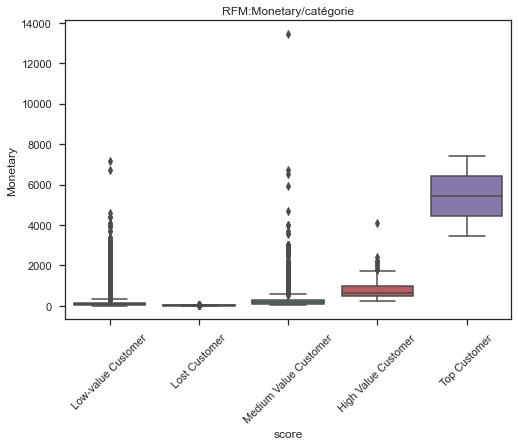

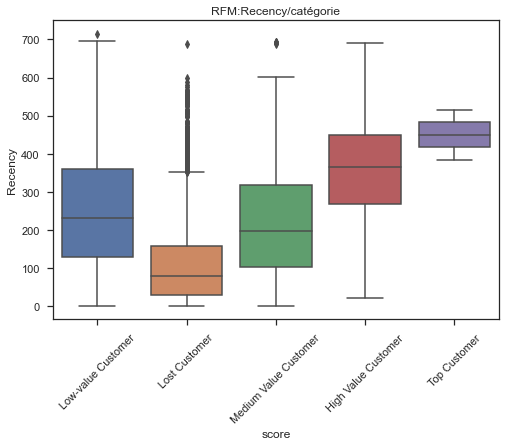

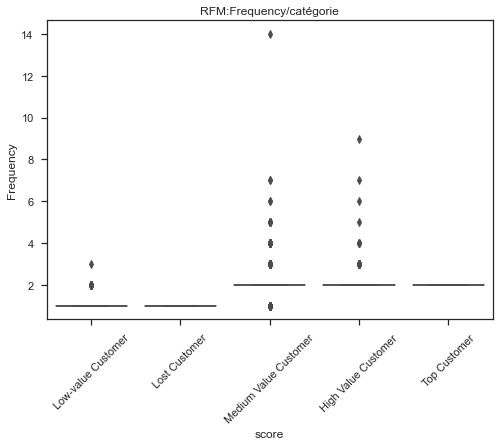

In [143]:
for k in ["Monetary", "Recency", "Frequency"]:
    sns.boxplot(data=df_rfm[[k, "score"]], x="score", y=k)
    plt.xticks(rotation=45)
    plt.title("RFM:" + k + "/catégorie")
    plt.show()

In [38]:
df_rfm.columns

Index(['Frequency', 'Monetary', 'Recency', 'boxcox_Monetary', 'boxcoxRecency',
       'Frequency_1vspls', 'score'],
      dtype='object')

In [43]:
pca = PCA()
standscal = StandardScaler()
x_trans = standscal.fit_transform(
    df_rfm[["boxcox_Monetary", "boxcoxRecency", "Frequency_1vspls"]]
)
rfm_pca = pca.fit_transform(x_trans)

In [45]:
pca.explained_variance_ratio_.cumsum()

array([0.38131512, 0.7140888 , 1.        ])

In [47]:
pca = PCA()
standscal = StandardScaler()
x_trans_ = standscal.fit_transform(df_rfm[["boxcox_Monetary", "boxcoxRecency"]])
rfm_pca_ = pca.fit_transform(x_trans_)

In [48]:
pca.explained_variance_ratio_.cumsum()

array([0.50330647, 1.        ])

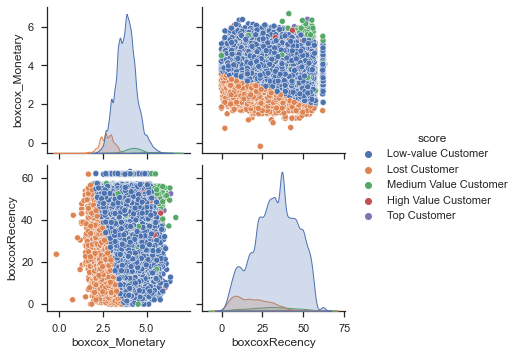

In [53]:
sns.pairplot(df_rfm[["boxcox_Monetary", "boxcoxRecency", "score"]], hue="score")

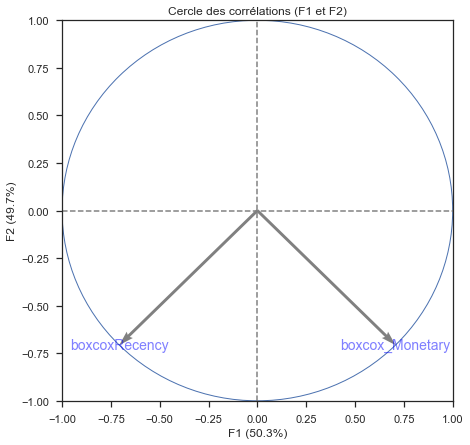

In [51]:
display_circles(
    pca.components_,
    len(np.cumsum(pca.explained_variance_ratio_)),
    pca,
    [(0, 1), (2, 3), (4, 5)],
    labels=["boxcox_Monetary", "boxcoxRecency"],
)

In [39]:
scaler = MinMaxScaler(feature_range=(1, 100))
rfm_ = pd.DataFrame(
    scaler.fit_transform(df_rfm[["Frequency", "boxcoxRecency", "boxcox_Monetary"]]),
    columns=["F", "R", "M"],
    index=df_rfm.index,
)

In [40]:
xt, _ = stats.boxcox(df_rfm.Frequency)
df_rfm["boxcox_freq"] = xt

In [41]:
score_rfm = rfm_.apply(lambda x: (x.F * 0.28 + 0.15 * x.R + 0.57 * x.M) * 0.05, axis=1)

In [42]:
score_rfm.describe()

count    92057.000000
mean         2.036991
std          0.315019
min          0.328185
25%          1.826851
50%          2.041302
75%          2.246804
max          3.641339
dtype: float64

Etant donnée que nous voyons que dans le rfm on dispose de la fréquence qui semble être pas assez significatif par le manque de présence de plus de deux commandes par clients on va prendre un autre facteur qui est le review. 

In [54]:
df_.columns

Index(['order_id', 'customer_unique_id', 'cat_mode_order',
       'total_weight_order', 'volume_totat_order_cm3', 'price',
       'pourcentage_livraison', 'nb_article', 'heure_commande',
       'temps_commande_reception', 'order_purchase_timestamp',
       'nombre_review_commande', 'review_score', 'semaine_vs_weekend',
       'cat_creneautravailoupas', 'Distance_cust_seller_km',
       'geolocation_lat_sellers', 'geolocation_lng_sellers', 'customer_state'],
      dtype='object')

In [56]:
df_v2 = df_.groupby("customer_unique_id").agg(
    {"price": "mean", "review_score": "mean", "order_purchase_timestamp": "max"}
)

In [58]:
df_v2.order_purchase_timestamp = df_v2.order_purchase_timestamp.apply(
    lambda x: (df_v2.order_purchase_timestamp.max() - x).days
)

In [59]:
df_v2.head()

,price,review_score,order_purchase_timestamp
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.90,5.0,111
0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,4.0,114
0000f46a3911fa3c0805444483337064,69.00,3.0,536
0000f6ccb0745a6a4b88665a16c9f078,25.99,4.0,320
0004aac84e0df4da2b147fca70cf8255,180.00,5.0,287


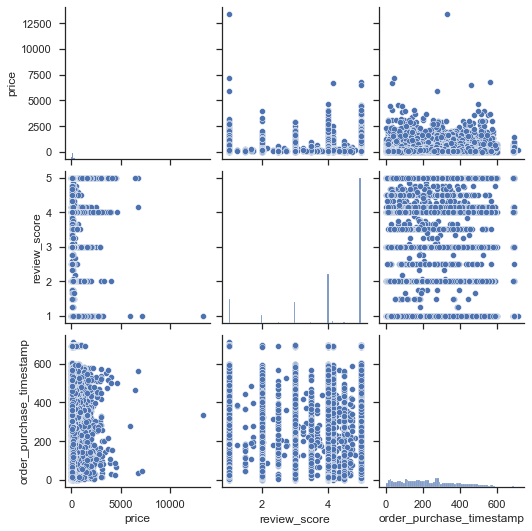

In [61]:
sns.pairplot(df_v2)

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\miche\anaconda3\envs\tf\lib\si

<AxesSubplot:ylabel='Density'>

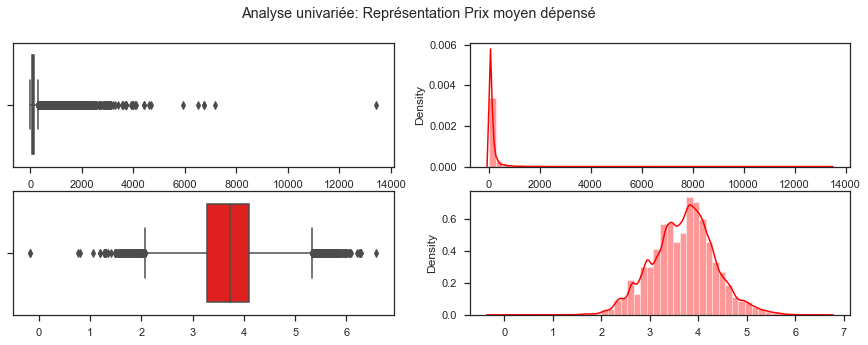

In [62]:
fig, ax = plt.subplots(2, 2, figsize=(15, 5))
sns.boxplot(df_v2.price, ax=ax[0, 0], color="red")
sns.distplot(df_v2.price, ax=ax[0, 1], color="red")
plt.suptitle("Analyse univariée: Représentation Prix moyen dépensé")

xt, _ = stats.boxcox(df_v2.price)
sns.boxplot(xt, ax=ax[1, 0], color="red")
sns.distplot(xt, ax=ax[1, 1], color="red")

In [64]:
df_v2["price_t"] = xt

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

C:\Users\miche\anaconda3\envs\tf\lib\si

<AxesSubplot:ylabel='Density'>

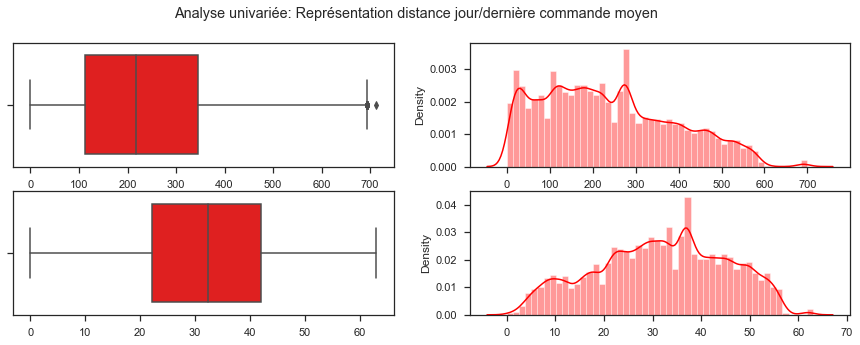

In [144]:
fig, ax = plt.subplots(2, 2, figsize=(15, 5))
sns.boxplot(df_v2.order_purchase_timestamp, ax=ax[0, 0], color="red")
sns.distplot(df_v2.order_purchase_timestamp, ax=ax[0, 1], color="red")
plt.suptitle("Analyse univariée: Représentation distance jour/dernière commande moyen ")

xt, _ = stats.boxcox(df_v2.order_purchase_timestamp + 1)
sns.boxplot(xt, ax=ax[1, 0], color="red")
sns.distplot(xt, ax=ax[1, 1], color="red")

In [69]:
df_v2["nb jour dernière commande"] = xt

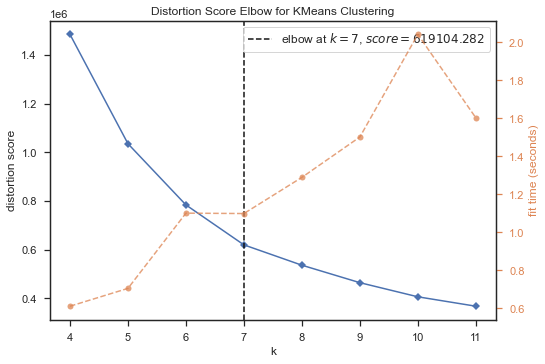

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [70]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 12))

visualizer.fit(df_v2[["nb jour dernière commande", "price_t", "review_score"]])
visualizer.poof()

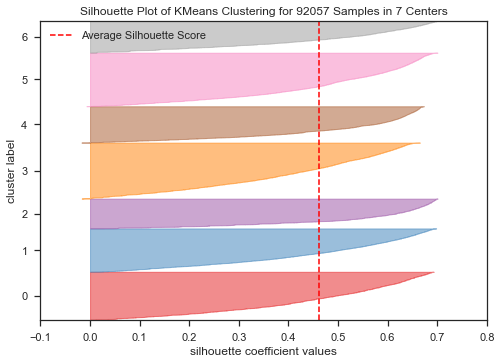

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 92057 Samples in 7 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [71]:
model = KMeans(7)

visualizer = SilhouetteVisualizer(model)

visualizer.fit(df_v2[["nb jour dernière commande", "price_t", "review_score"]])
visualizer.poof()

In [77]:
df_v2["cluster"] = visualizer.estimator.labels_

In [81]:
df_v2.sample(1000).cluster.value_counts()

3    180
5    176
0    156
1    151
4    123
2    108
6    106
Name: cluster, dtype: int64

In [ ]:
df_v2.sample(1000)

In [82]:
df_v2.head(2)

,price,review_score,order_purchase_timestamp,price_t,nb jour dernière commande,cluster
customer_unique_id,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.9,5.0,111,4.006502,21.938174,0
0000b849f77a49e4a4ce2b2a4ca5be3f,18.9,4.0,114,2.609201,22.281181,0


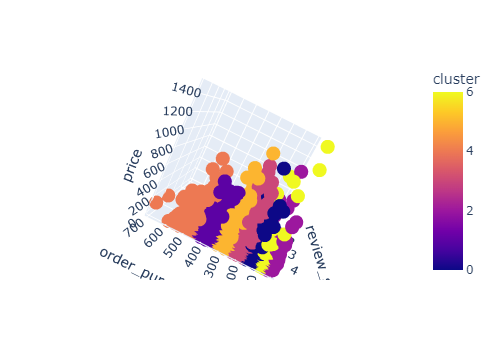

In [100]:
fig = px.scatter_3d(
    df_v2.sample(1000, random_state=42),
    x="review_score",
    y="price",
    z="order_purchase_timestamp",
    color="cluster",
)
fig.show()

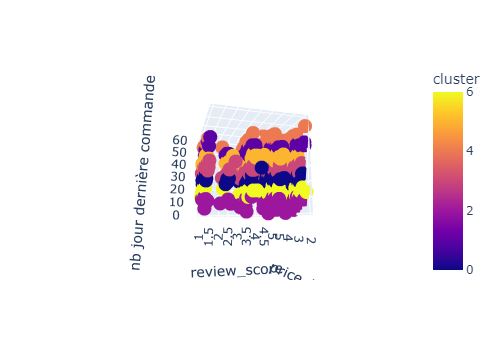

In [95]:
fig = px.scatter_3d(
    df_v2.sample(1000, random_state=42),
    x="review_score",
    y="price_t",
    z="nb jour dernière commande",
    color="cluster",
)
fig.show()

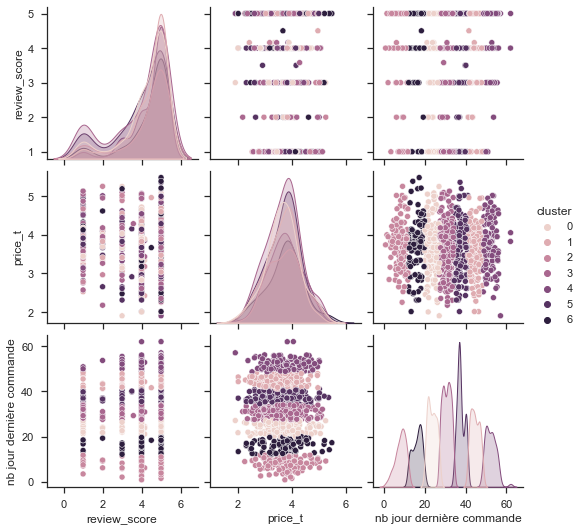

In [87]:
sns.pairplot(
    data=df_v2.sample(1000, random_state=42),
    vars=["review_score", "price_t", "nb jour dernière commande"],
    hue="cluster",
)

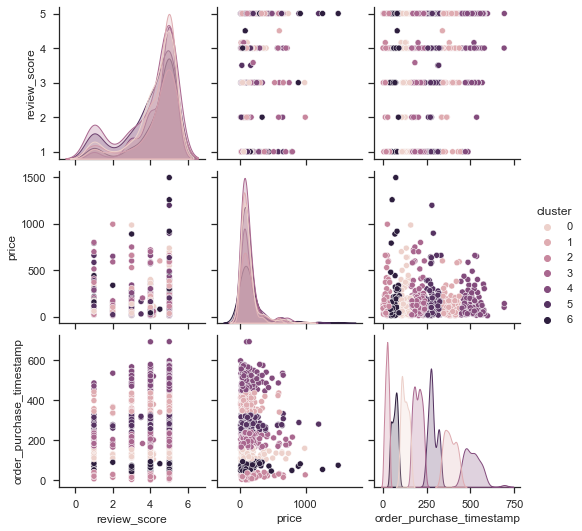

In [145]:
sns.pairplot(
    data=df_v2.sample(1000, random_state=42),
    vars=["review_score", "price", "order_purchase_timestamp"],
    hue="cluster",
)

In [146]:
df_v2.head(2)

,price,review_score,order_purchase_timestamp,price_t,nb jour dernière commande,cluster,cluster_scaled,nb_jour_scaled,price_t_scaled,review_score_scaled
customer_unique_id,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.9,5.0,111,4.006502,21.938174,0,5,-0.727258,0.484644,0.663005
0000b849f77a49e4a4ce2b2a4ca5be3f,18.9,4.0,114,2.609201,22.281181,0,4,-0.701584,-1.700952,-0.121643


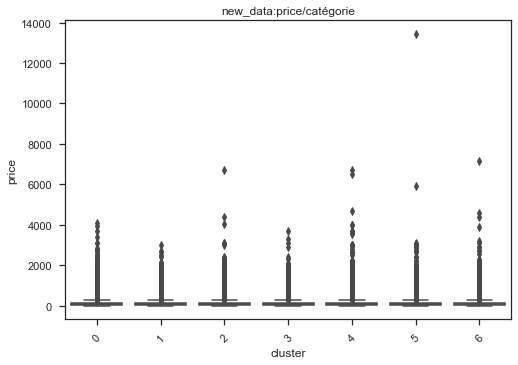

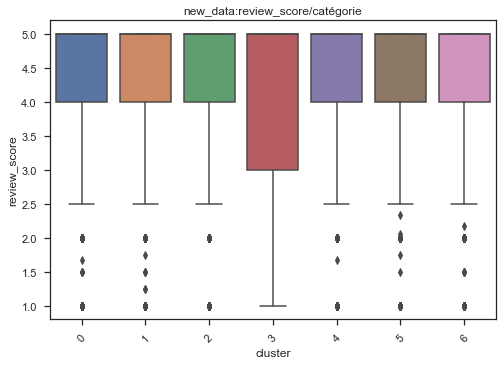

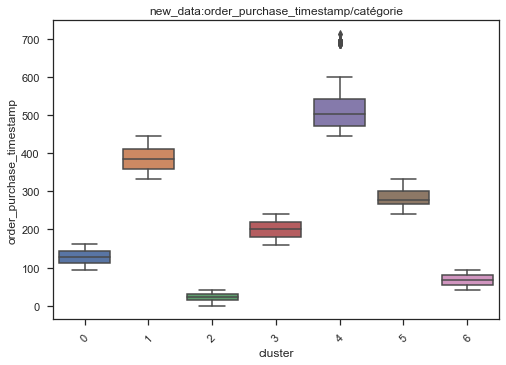

In [148]:
for k in ["price", "review_score", "order_purchase_timestamp"]:
    sns.boxplot(data=df_v2[[k, "cluster"]], x="cluster", y=k)
    plt.xticks(rotation=45)
    plt.title("new_data:" + k + "/cluster")
    plt.show()

On a pas scaler... 

In [92]:
scal = StandardScaler()
x_scal = scal.fit_transform(
    df_v2[["nb jour dernière commande", "price_t", "review_score"]]
)

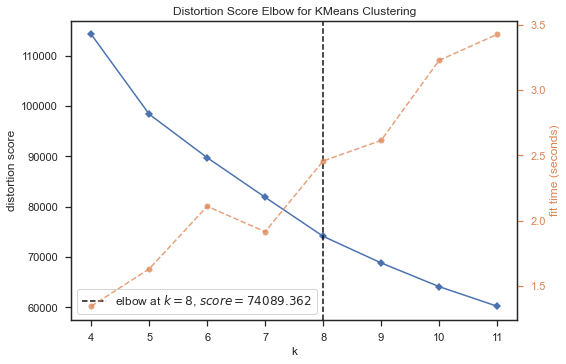

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [93]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 12))

visualizer.fit(x_scal)
visualizer.poof()

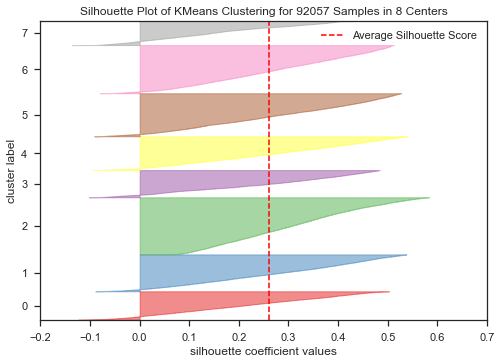

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 92057 Samples in 8 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [94]:
model = KMeans(8)

visualizer = SilhouetteVisualizer(model)

visualizer.fit(x_scal)
visualizer.poof()

In [101]:
df_v2["cluster_scaled"] = visualizer.estimator.labels_

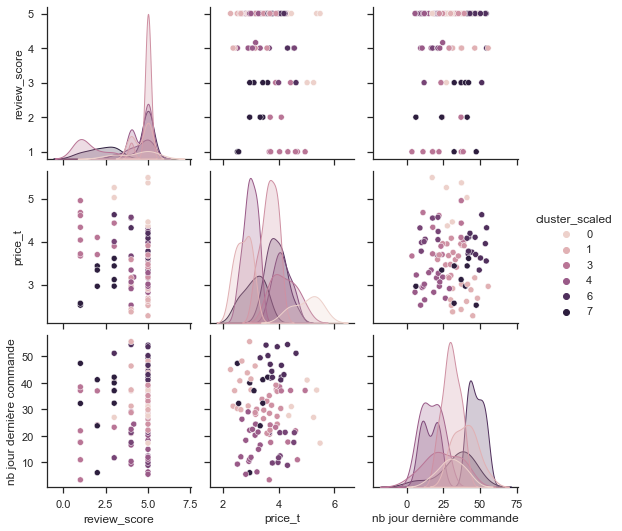

In [133]:
sns.pairplot(
    data=df_v2.sample(100, random_state=42),
    vars=["review_score", "price_t", "nb jour dernière commande"],
    hue="cluster_scaled",
)

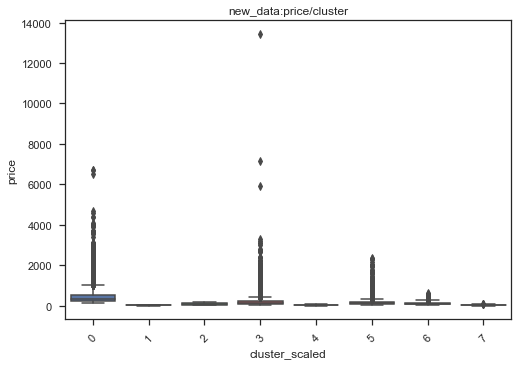

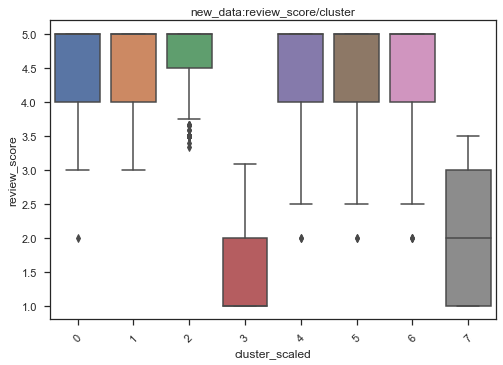

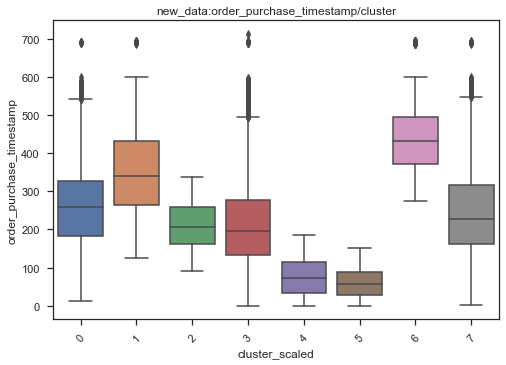

In [149]:
for k in ["price", "review_score", "order_purchase_timestamp"]:
    sns.boxplot(data=df_v2[[k, "cluster_scaled"]], x="cluster_scaled", y=k)
    plt.xticks(rotation=45)
    plt.title("new_data:" + k + "/cluster")
    plt.show()

In [107]:
df_v2[["cluster", "order_purchase_timestamp"]].groupby("cluster").describe()

order_purchase_timestamp                                              \
                           count        mean        std    min    25%    50%   
cluster                                                                        
0                        14786.0  127.750101  18.606572   95.0  112.0  127.0   
1                        13353.0  385.672658  31.694028  333.0  358.0  385.0   
2                         9176.0   22.074215  10.306858    0.0   14.0   22.0   
3                        17251.0  199.966205  22.618435  160.0  181.0  200.0   
4                        11190.0  510.727703  48.805374  445.0  471.0  504.0   
5                        16495.0  283.669536  23.861324  240.0  266.0  278.0   
6                         9806.0   67.383235  15.039075   41.0   55.0   68.0   

                       
           75%    max  
cluster                
0        144.0  161.0  
1        412.0  445.0  
2         30.0   40.0  
3        220.0  240.0  
4        541.0  713.0  
5        302.0  333.0  
6         80.0   94.0

In [106]:
df_v2[["cluster", "review_score"]].groupby("cluster").describe()

review_score                                             
               count      mean       std  min  25%  50%  75%  max
cluster                                                          
0            14786.0  4.192708  1.245319  1.0  4.0  5.0  5.0  5.0
1            13353.0  4.273249  1.159507  1.0  4.0  5.0  5.0  5.0
2             9176.0  4.313097  1.153481  1.0  4.0  5.0  5.0  5.0
3            17251.0  3.917355  1.435469  1.0  3.0  5.0  5.0  5.0
4            11190.0  4.186770  1.226214  1.0  4.0  5.0  5.0  5.0
5            16495.0  4.075824  1.325284  1.0  4.0  5.0  5.0  5.0
6             9806.0  4.304456  1.166922  1.0  4.0  5.0  5.0  5.0

In [105]:
df_v2[["cluster", "price"]].groupby("cluster").describe()

price                                                              
           count        mean         std   min    25%    50%     75%       max
cluster                                                                       
0        14786.0  142.002945  213.071552  0.85  48.00  89.90  150.00   4099.99
1        13353.0  135.787095  190.207890  2.29  48.00  84.99  149.99   2999.89
2         9176.0  134.544374  214.238523  2.20  45.48  81.00  149.00   6729.00
3        17251.0  131.162816  173.716448  2.99  45.00  85.80  149.90   3690.00
4        11190.0  142.165396  240.435760  4.50  44.90  86.99  149.99   6735.00
5        16495.0  137.489425  220.527163  3.85  49.00  86.80  149.99  13440.00
6         9806.0  142.716786  225.939150  3.50  46.99  89.90  150.00   7160.00

In [110]:
df_v2[["cluster_scaled", "order_purchase_timestamp"]].groupby(
    "cluster_scaled"
).describe()

order_purchase_timestamp                                        \
                                  count        mean         std    min    25%   
cluster_scaled                                                                  
0                                8774.0  264.947914  108.375946   13.0  183.0   
1                               11366.0  350.812159  109.447529  126.0  265.0   
2                               17587.0  208.407233   56.643932   92.0  161.0   
3                                8375.0  219.606567  127.126217    0.0  134.0   
4                               10404.0   76.995867   48.517236    0.0   33.0   
5                               13257.0   59.801388   36.870502    0.0   27.0   
6                               14830.0  437.705664   80.415902  275.0  372.0   
7                                7464.0  247.109861  127.391937    1.0  162.0   

                                      
                  50%     75%    max  
cluster_scaled                        
0               260.0  326.75  693.0  
1               339.0  432.00  694.0  
2               207.0  259.00  337.0  
3               197.0  278.00  713.0  
4                73.0  115.00  186.0  
5                57.0   88.00  152.0  
6               431.0  495.00  694.0  
7               227.0  316.00  694.0

In [111]:
df_v2[["cluster_scaled", "review_score"]].groupby("cluster_scaled").describe()

review_score                                               \
                      count      mean       std       min  25%  50%  75%   
cluster_scaled                                                             
0                    8774.0  4.642883  0.578508  2.000000  4.0  5.0  5.0   
1                   11366.0  4.681436  0.532544  3.000000  4.0  5.0  5.0   
2                   17587.0  4.748089  0.433872  3.333333  4.5  5.0  5.0   
3                    8375.0  1.506791  0.761457  1.000000  1.0  1.0  2.0   
4                   10404.0  4.668831  0.562433  2.000000  4.0  5.0  5.0   
5                   13257.0  4.631607  0.606897  2.000000  4.0  5.0  5.0   
6                   14830.0  4.579546  0.636361  2.000000  4.0  5.0  5.0   
7                    7464.0  1.947916  0.901887  1.000000  1.0  2.0  3.0   

                          
                     max  
cluster_scaled            
0               5.000000  
1               5.000000  
2               5.000000  
3               3.078807  
4               5.000000  
5               5.000000  
6               5.000000  
7               3.500000

In [114]:
df_v2[["cluster_scaled", "price"]].groupby("cluster_scaled").describe()

price                                                   \
                  count        mean         std     min     25%      50%   
cluster_scaled                                                             
0                8774.0  468.314232  419.247560  159.00  233.91  329.900   
1               11366.0   29.044521   10.966339    0.85   19.90   29.000   
2               17587.0   89.914046   34.114310   34.90   59.90   84.000   
3                8375.0  227.441223  303.634402   59.89  110.00  150.000   
4               10404.0   35.025947   14.110255    2.20   24.90   34.445   
5               13257.0  170.080965  140.342252   59.90   99.00  133.800   
6               14830.0  119.506232   60.381983   36.49   73.00  103.565   
7                7464.0   47.104876   21.313313    3.54   29.90   46.855   

                                  
                   75%       max  
cluster_scaled                    
0               549.99   6735.00  
1                37.90     56.00  
2               114.00    190.00  
3               229.99  13440.00  
4                46.90     66.99  
5               189.99   2338.08  
6               149.90    629.90  
7                59.90    105.60

In [116]:
df_v2.columns

Index(['price', 'review_score', 'order_purchase_timestamp', 'price_t',
       'nb jour dernière commande', 'cluster', 'cluster_scaled'],
      dtype='object')

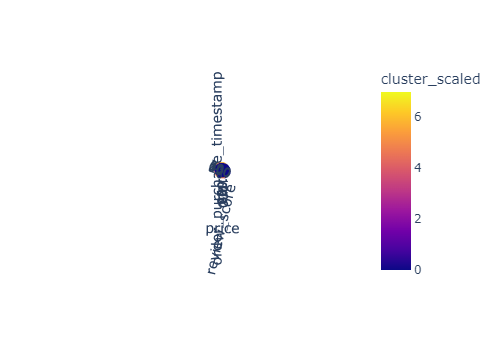

In [118]:
fig = px.scatter_3d(
    df_v2.sample(1000, random_state=42),
    x="review_score",
    y="price",
    z="order_purchase_timestamp",
    color="cluster_scaled",
)
fig.show()

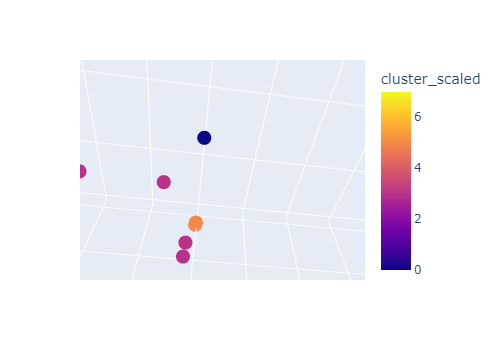

In [117]:
fig = px.scatter_3d(
    df_v2.sample(1000, random_state=42),
    x="review_score",
    y="price_t",
    z="nb jour dernière commande",
    color="cluster_scaled",
)
fig.show()

In [121]:
df_v2[["nb_jour_scaled", "price_t_scaled", "review_score_scaled"]] = x_scal

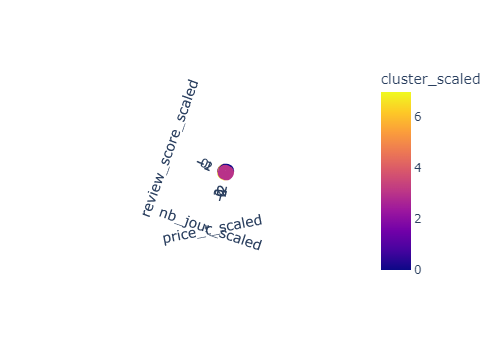

In [122]:
fig = px.scatter_3d(
    df_v2.sample(1000, random_state=42),
    x="nb_jour_scaled",
    y="price_t_scaled",
    z="review_score_scaled",
    color="cluster_scaled",
)
fig.show()

on Bouge reviews car on voit qu'il y a un soucis sur le review. Voyons peut-être avec la distance et le temps de reception

In [125]:
df_.Distance_cust_seller_km.describe()

count    95104.000000
mean       534.102989
std        617.056776
min          0.000000
25%          0.000000
50%        426.472203
75%        818.267566
max       3310.827734
Name: Distance_cust_seller_km, dtype: float64

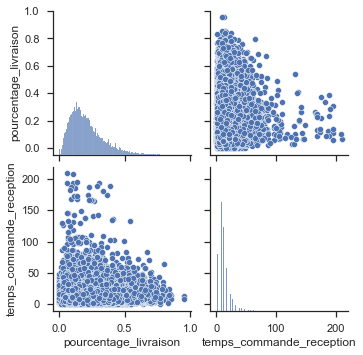

In [99]:
sns.pairplot(df_[["pourcentage_livraison", "temps_commande_reception"]])

In [132]:
pd.crosstab(df_v2.cluster, df_v2.cluster_scaled)

cluster_scaled,0,1,2,3,4,5,6,7
cluster,,,,,,,,
0,1343,4,4453,1561,3412,2849,0,1164
1,1422,3343,18,705,0,0,6908,957
2,17,0,0,558,3192,5106,0,303
3,2346,2163,7538,2488,514,0,0,2202
4,660,2546,0,618,0,0,6673,693
5,2763,3310,5571,1808,0,0,1249,1794
6,223,0,7,637,3286,5302,0,351


### Kmeans avec 5 variables

On va essayé de segmenter les clients selon plusieurs critères: 

        - la durée de livraison moyenne
        - le review moyen sur les commandes passées
        - le prix moyen par commande
        - pourcentage fret 
        -la distance en km entre région vendeur/client

In [151]:
df_.head(3)

,order_id,customer_unique_id,cat_mode_order,total_weight_order,volume_totat_order_cm3,price,pourcentage_livraison,nb_article,heure_commande,temps_commande_reception,order_purchase_timestamp,nombre_review_commande,review_score,semaine_vs_weekend,cat_creneautravailoupas,Distance_cust_seller_km,geolocation_lat_sellers,geolocation_lng_sellers,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,7c396fd4830fd04220f754e42b4e5bff,consommable,500.0,1976.0,29.99,0.225265,1,10,8.0,2017-10-02 10:56:33,1.0,4.0,jour_travail,temps_prof,0.000000,-23.155308,-47.084074,Est
1,53cdb2fc8bc7dce0b6741e2150273451,af07308b275d755c9edb36a90c618231,consommable,400.0,4693.0,118.70,0.160894,1,20,13.0,2018-07-24 20:41:37,1.0,4.0,jour_travail,temps_perso,1375.789636,-13.049361,-39.560649,Nord_Est
2,47770eb9100c2d0c44946d9cf07ec65d,3a653a41f6f9fc3d2a113cf8398680e8,service_outils,420.0,9576.0,159.90,0.107302,1,8,9.0,2018-08-08 08:38:49,1.0,5.0,jour_travail,temps_perso,768.269422,-16.577645,-49.334195,Ouest


In [4]:
df_clust = df_.groupby("customer_unique_id").agg(
    {
        "Distance_cust_seller_km": "mean",
        "review_score": "mean",
        "temps_commande_reception": "mean",
        "pourcentage_livraison": "mean",
        "price": "mean",
    }
)

In [5]:
std_scl = StandardScaler()

In [6]:
test2 = pd.DataFrame(
    std_scl.fit_transform(df_clust), columns=df_clust.columns, index=df_clust.index
)

In [233]:
test2.head(2)

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price
customer_unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.867025,0.663005,-0.638876,-0.995748,-0.036788
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.867025,-0.121643,-0.953117,0.770019,-0.566183


In [163]:
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

In [165]:
model = model.fit(test2.sample(10000))

In [169]:
def plot_dendrogram(model, **kwargs):
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    dendrogram(linkage_matrix, **kwargs)

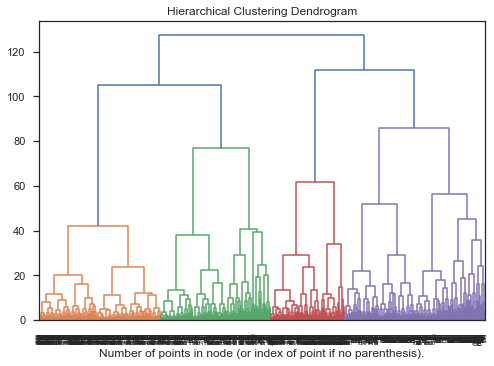

In [170]:
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=10)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

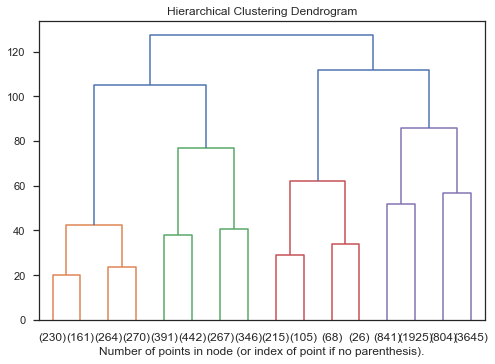

In [173]:
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

In [171]:
model2 = AgglomerativeClustering(distance_threshold=0, n_clusters=None)

model2 = model2.fit(test2.sample(50000))

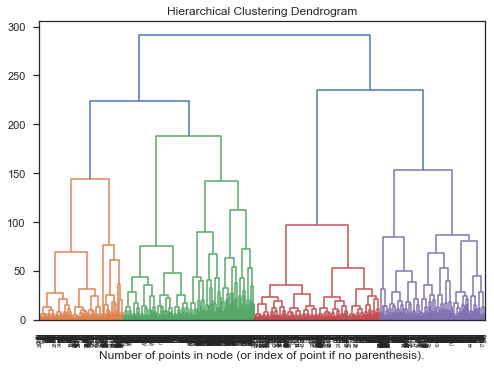

In [172]:
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model2, truncate_mode="level", p=10)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

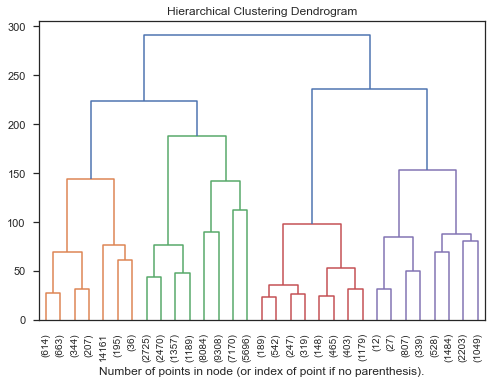

In [177]:
plt.title("Hierarchical Clustering Dendrogram")
# plot the top three levels of the dendrogram
plot_dendrogram(model2, truncate_mode="level", p=4)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.xticks(rotation=90, fontsize=10)
plt.show()

36007    1
20863    1
17525    1
27437    1
27606    1
        ..
41888    1
34845    1
35031    1
15416    1
0        1
Length: 50000, dtype: int64

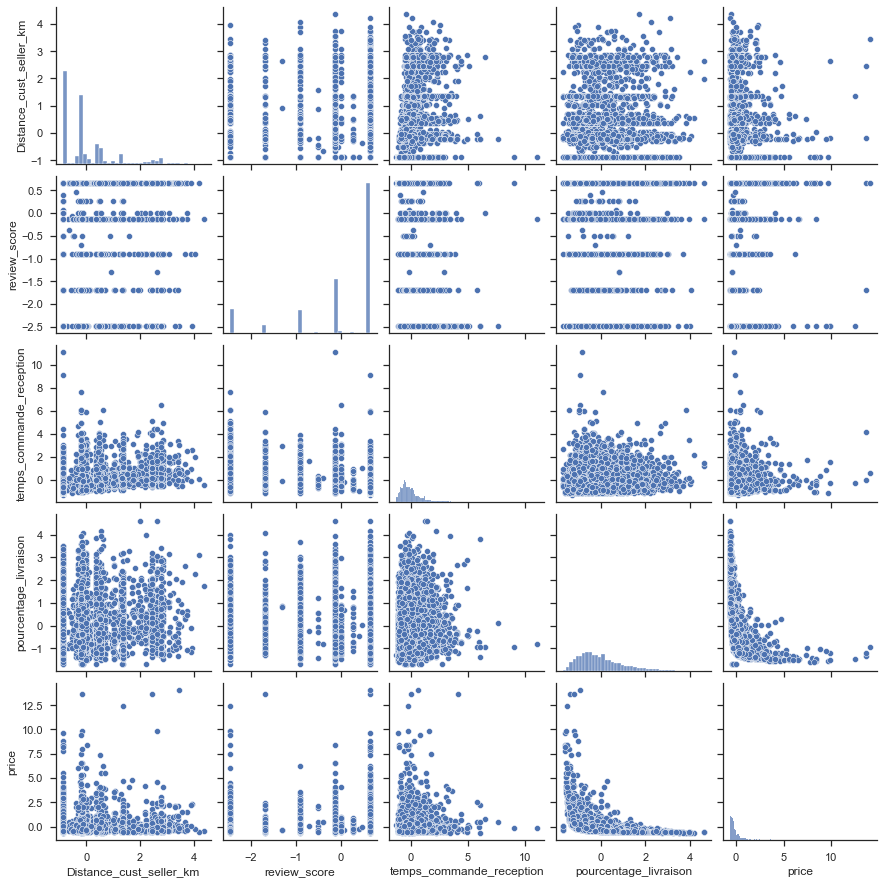

In [179]:
sns.pairplot(test2.sample(5000))

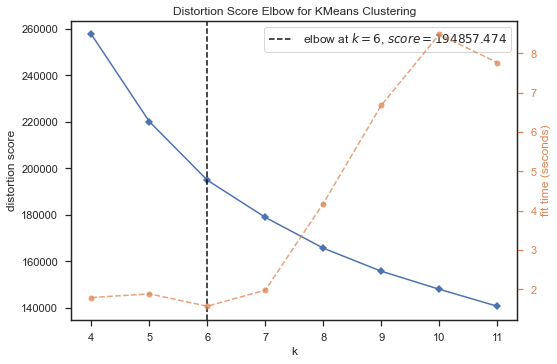

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [181]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 12))

visualizer.fit(test2)
visualizer.poof()

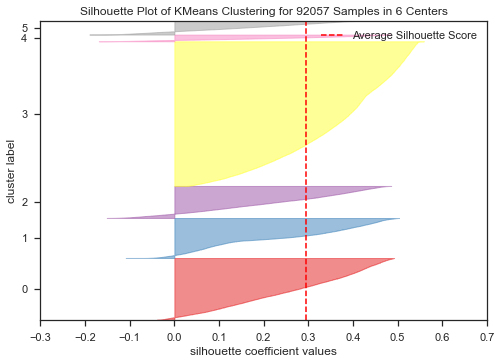

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 92057 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [182]:
model = KMeans(6)

visualizer = SilhouetteVisualizer(model)

visualizer.fit(test2)
visualizer.poof()

In [184]:
pd.Series(visualizer.estimator.labels_).value_counts()

3    44570
0    19027
1    12321
2     9862
5     4218
4     2059
dtype: int64

In [206]:
db = DBSCAN(eps=0.5, min_samples=5).fit(test2)

In [201]:
pd.Series(db.labels_).value_counts()

 0    91242
-1      751
 4       11
 3        9
 2        8
 5        8
 1        7
 7        7
 6        5
 9        5
 8        4
dtype: int64

In [ ]:
model = db

visualizer2 = SilhouetteVisualizer(model)
pd.Series(db.labels_).value_counts()
visualizer2.fit(test2)
visualizer2.poof()

In [207]:
data_clustm = test2.copy()
data_clustm["cluster"] = visualizer.estimator.labels_

In [210]:
data_clustm.cluster.value_counts()

3    44570
0    19027
1    12321
2     9862
5     4218
4     2059
Name: cluster, dtype: int64

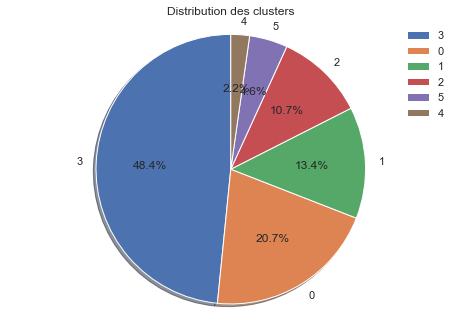

In [213]:
labels = data_clustm.cluster.value_counts().index
sizes = data_clustm.cluster.value_counts().values

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, autopct="%1.1f%%", shadow=True, startangle=90)
ax1.axis("equal")  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.legend()
plt.title("Distribution des clusters")
plt.show()

In [214]:
data_clustm.head(2)

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price,cluster
customer_unique_id,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.867025,0.663005,-0.638876,-0.995748,-0.036788,3
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.867025,-0.121643,-0.953117,0.770019,-0.566183,0


In [371]:
df_clust.head()

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price
customer_unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.000000,5.0,6.0,0.084567,129.90
0000b849f77a49e4a4ce2b2a4ca5be3f,0.000000,4.0,3.0,0.304892,18.90
0000f46a3911fa3c0805444483337064,519.122328,3.0,25.0,0.199722,69.00
0000f6ccb0745a6a4b88665a16c9f078,2296.795588,4.0,20.0,0.404172,25.99
0004aac84e0df4da2b147fca70cf8255,0.000000,5.0,13.0,0.085784,180.00


In [368]:
data_6_melt = pd.melt(
    data_clustm.reset_index(),
    id_vars=["customer_unique_id", "cluster"],
    value_vars=[
        "Distance_cust_seller_km",
        "review_score",
        "temps_commande_reception",
        "pourcentage_livraison",
        "price",
    ],
    var_name="Attribute",
    value_name="Value",
)

([0, 1, 2, 3, 4],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

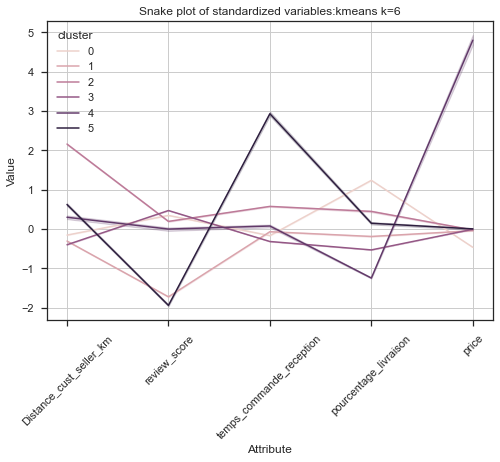

In [403]:
sns.lineplot(x="Attribute", y="Value", hue="cluster", data=data_6_melt)
plt.title("Snake plot of standardized variables:kmeans k=6")
plt.grid()
plt.xticks(rotation=45)

In [376]:
cluster_avg = df_orgdata_clust.groupby(["cluster"]).mean()
population_avg = df_orgdata_clust.drop("cluster", axis=1).mean()
relative_imp = cluster_avg / population_avg - 1

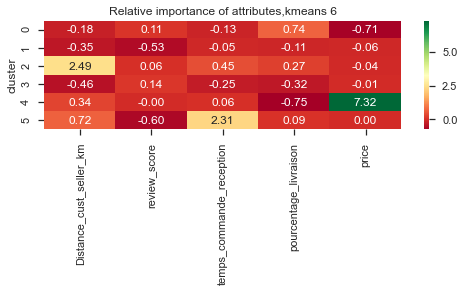

In [377]:
plt.figure(figsize=(8, 2))
plt.title("Relative importance of attributes,kmeans 6")
sns.heatmap(data=relative_imp, annot=True, fmt=".2f", cmap="RdYlGn")
plt.show()

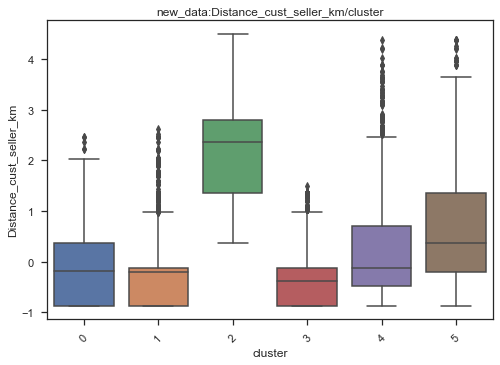

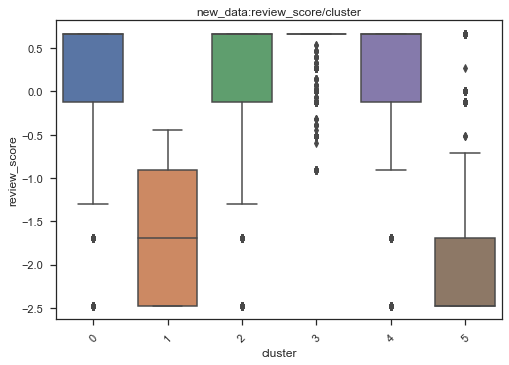

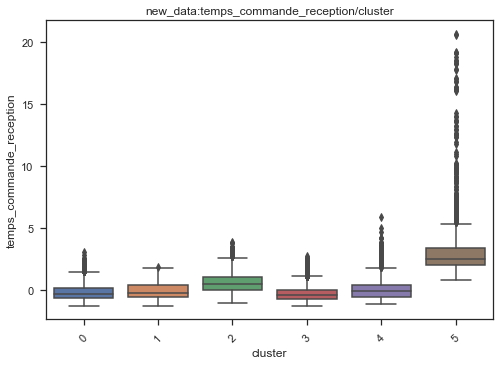

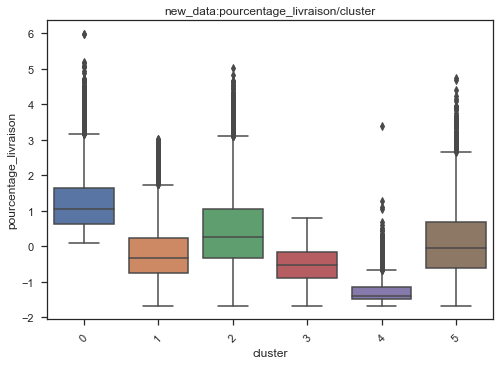

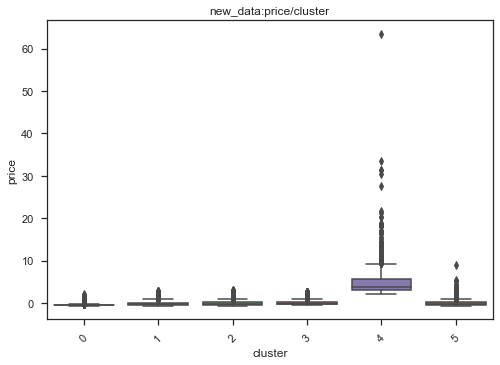

In [215]:
for k in [
    "Distance_cust_seller_km",
    "review_score",
    "temps_commande_reception",
    "pourcentage_livraison",
    "price",
]:
    sns.boxplot(data=data_clustm[[k, "cluster"]], x="cluster", y=k)
    plt.xticks(rotation=45)
    plt.title("new_data:" + k + "/cluster")
    plt.show()

In [217]:
df_orgdata_clust = df_clust.copy()
df_orgdata_clust["cluster"] = visualizer.estimator.labels_

In [222]:
df_orgdata_clust.groupby("cluster").price.describe()

,count,mean,std,min,25%,50%,75%,max
cluster,,,,,,,,
0,19027.0,40.122342,33.481535,0.85,19.970,29.99,47.4000,584.95
1,12321.0,128.678083,109.698106,6.50,54.990,98.00,159.9400,740.99
2,9862.0,132.574652,116.755363,4.90,55.000,99.90,160.5125,799.90
3,44570.0,136.239467,103.778229,20.99,68.500,104.90,169.0000,679.99
4,2059.0,1144.634462,664.767931,580.27,773.625,933.98,1299.9000,13440.00
5,4218.0,138.215296,140.663835,3.54,51.920,98.80,167.9675,2029.00


           count         mean         std         min          25%  \
cluster                                                              
0        19027.0   439.834979  344.371553    0.000000     0.000000   
1        12321.0   346.170192  361.495230    0.000000     0.000000   
2         9862.0  1869.333383  463.826286  759.946798  1375.789636   
3        44570.0   288.232674  318.431754    0.000000     0.000000   
4         2059.0   719.949220  690.161524    0.000000   244.235651   
5         4218.0   920.348210  692.940857    0.000000   404.843018   

                 50%          75%          max  
cluster                                         
0         426.472203   759.946798  2057.337784  
1         404.843018   457.949592  2154.388683  
2        1995.979579  2261.168097  3310.827734  
3         298.056020   457.949592  1452.657234  
4         457.949592   974.336352  3232.018221  
5         759.946798  1375.789636  3232.018221  


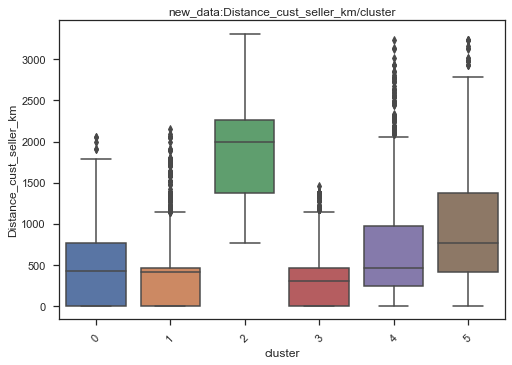

           count      mean       std  min  25%  50%  75%       max
cluster                                                           
0        19027.0  4.595774  0.659929  1.0  4.0  5.0  5.0  5.000000
1        12321.0  1.956853  0.913010  1.0  1.0  2.0  3.0  3.578807
2         9862.0  4.402056  0.908336  1.0  4.0  5.0  5.0  5.000000
3        44570.0  4.754244  0.431183  3.0  5.0  5.0  5.0  5.000000
4         2059.0  4.153001  1.306957  1.0  4.0  5.0  5.0  5.000000
5         4218.0  1.679606  1.125992  1.0  1.0  1.0  2.0  5.000000


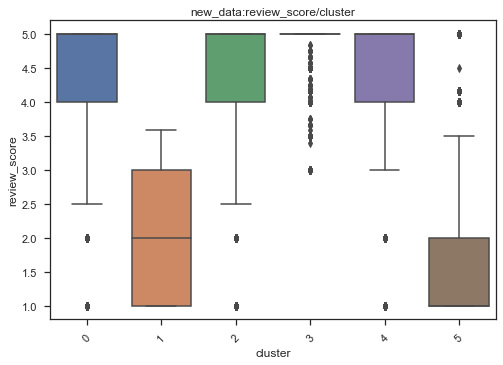

           count       mean        std   min   25%   50%   75%    max
cluster                                                              
0        19027.0  10.491058   5.608593   0.0   6.0   9.0  14.0   41.0
1        12321.0  11.446710   6.311186   0.0   7.0  10.0  16.0   30.0
2         9862.0  17.593295   7.018456   2.0  12.0  17.0  22.0   49.0
3        44570.0   9.067851   5.424897   0.0   5.0   8.0  12.0   38.0
4         2059.0  12.829043   8.324850   1.0   7.0  11.0  16.0   68.0
5         4218.0  40.089102  17.515051  19.5  31.0  36.0  44.0  209.0


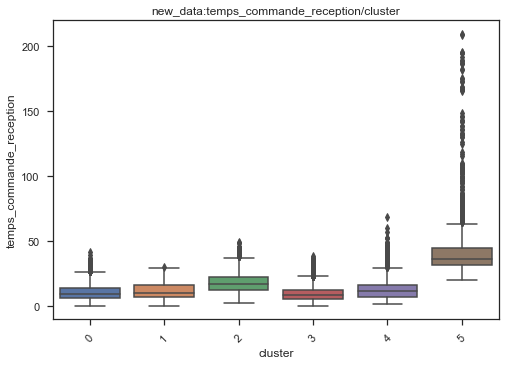

           count      mean       std       min       25%       50%       75%  \
cluster                                                                        
0        19027.0  0.363338  0.096695  0.220312  0.288229  0.339270  0.414706   
1        12321.0  0.185192  0.095651  0.000000  0.114773  0.169453  0.239156   
2         9862.0  0.264627  0.134992  0.000000  0.165997  0.242819  0.338295   
3        44570.0  0.142483  0.057890  0.000000  0.097530  0.141458  0.189326   
4         2059.0  0.053200  0.047628  0.000000  0.024461  0.034839  0.065120   
5         4218.0  0.227082  0.128486  0.000000  0.132524  0.203091  0.295264   

              max  
cluster            
0        0.955451  
1        0.585609  
2        0.835239  
3        0.308441  
4        0.630926  
5        0.799320  


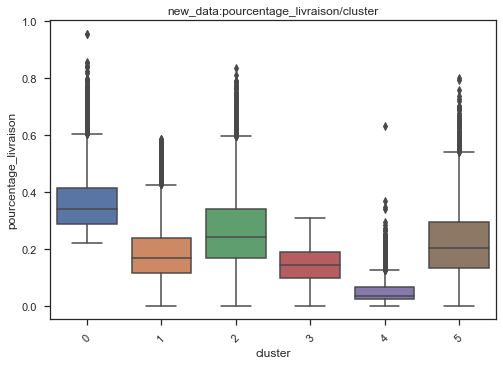

           count         mean         std     min      25%     50%        75%  \
cluster                                                                         
0        19027.0    40.122342   33.481535    0.85   19.970   29.99    47.4000   
1        12321.0   128.678083  109.698106    6.50   54.990   98.00   159.9400   
2         9862.0   132.574652  116.755363    4.90   55.000   99.90   160.5125   
3        44570.0   136.239467  103.778229   20.99   68.500  104.90   169.0000   
4         2059.0  1144.634462  664.767931  580.27  773.625  933.98  1299.9000   
5         4218.0   138.215296  140.663835    3.54   51.920   98.80   167.9675   

              max  
cluster            
0          584.95  
1          740.99  
2          799.90  
3          679.99  
4        13440.00  
5         2029.00  


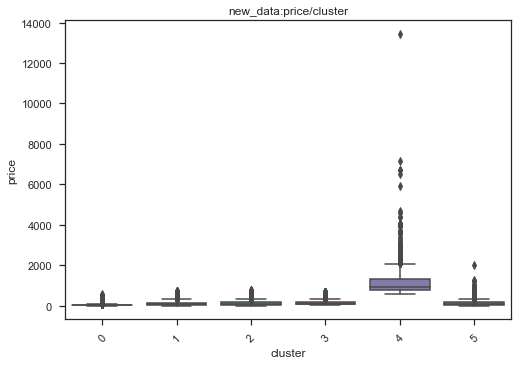

In [224]:
for k in [
    "Distance_cust_seller_km",
    "review_score",
    "temps_commande_reception",
    "pourcentage_livraison",
    "price",
]:
    sns.boxplot(data=df_orgdata_clust[[k, "cluster"]], x="cluster", y=k)
    plt.xticks(rotation=45)
    plt.title("new_data:" + k + "/cluster")
    print(df_orgdata_clust.groupby("cluster")[k].describe())
    plt.show()

In [239]:
pd.DataFrame(
    std_scl.inverse_transform(
        pd.DataFrame(visualizer.estimator.cluster_centers_, columns=test2.columns)
    ),
    columns=test2.columns,
).style.format("{:.3f}", na_rep="").bar(
    align=0,
    vmin=-2.5,
    vmax=2.5,
    cmap="bwr",
    height=50,
    width=60,
    props="width: 120px; border-right: 1px solid black;",
).text_gradient(
    cmap="bwr", vmin=-2.5, vmax=2.5
)

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price
0,440.197,4.595,10.493,0.364,40.107
1,346.107,1.957,11.444,0.185,128.699
2,1869.395,4.402,17.595,0.265,132.666
3,288.223,4.754,9.068,0.143,136.196
4,719.134,4.152,12.827,0.053,1145.079
5,920.271,1.679,40.089,0.227,138.208


In [258]:
nb_cust_clust = pd.Series(
    visualizer.estimator.labels_, name="nb_cust_clust"
).value_counts()

In [260]:
nb_cust_clust

3    44570
0    19027
1    12321
2     9862
5     4218
4     2059
Name: nb_cust_clust, dtype: int64

In [251]:
df_analyse_cluster = pd.DataFrame(
    std_scl.inverse_transform(
        pd.DataFrame(visualizer.estimator.cluster_centers_, columns=test2.columns)
    ),
    columns=test2.columns,
)

In [261]:
df_analyse_cluster = pd.merge(
    df_analyse_cluster, nb_cust_clust, left_index=True, right_index=True
)

In [264]:
df_analyse_cluster.style.bar(subset=df_analyse_cluster.columns, color="red")

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price,nb_cust_clust
0,440.196589,4.595284,10.493310,0.363506,40.106893,19027
1,346.107488,1.957019,11.443915,0.185150,128.699217,12321
2,1869.395254,4.402157,17.594614,0.264525,132.666114,9862
3,288.223411,4.754399,9.068330,0.142554,136.196032,44570
4,719.134163,4.152177,12.826932,0.053172,1145.078929,2059
5,920.270547,1.679369,40.088984,0.227106,138.207590,4218


la classe 3 est celle qui note le mieux, qui à reçu le plus rapidement en terme de délais de livraison, qui a payé de livraison peu proportionellement au prix total et à fait une dépense moyenne. C'est le cluster comptant le plus de client.

La classe 1 est la classe avec des reviews plûtot mauvais, qui n'a pas particulièrement attendu et payé la normale en terme de % pour la livraison. Elle a acheté pour un prix classique et est composé de 15% des clients

la classe 0 a donnée un bon review pourtant a payé en moyenne le plus de livraison pour un distance moyenne et une durée raisonnable. c'est un cluster qui dépense également le moins en moyenne 

la classe 2 est celle qui est plûtot satisfaite avec les clients patients dont la distance seller/cust est la plus grande. C'est un prix raisonnable de livraison et de dépense total moyen. Cluster de taille moyenne

La classe 4 est une classe interessante car elle correspond aux client satisfaits qui dépense le plus et qui ne sont pas exigeant sur le temps. elle dépense égalmeent le moins proportionnellement en pourcentage de livraison. Ce cluster est cependant le plus faible en terme de clients

La classe 5 est une classe qui donne de mauvaise note et on peut supposer cela par rapport au temps d'attente et à la distance entre sellet/cust. elle dépense la moyenne et donne 20% dans la livraison. 


On peut réunir la catégorie 1 et 5 qui sont des clients déçus soit par la livraison soit par la qualité des produits. 

Les clients de 0, 2,3,4 sont plûtot satisfait soit par leur produit soit par la rapidité donc des idéées viennent pour les maintenir ainsi.


In [240]:
pd.DataFrame(
    std_scl.inverse_transform(
        pd.DataFrame(visualizer.estimator.cluster_centers_, columns=test2.columns)
    ),
    columns=test2.columns,
)

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price
0,440.196589,4.595284,10.493310,0.363506,40.106893
1,346.107488,1.957019,11.443915,0.185150,128.699217
2,1869.395254,4.402157,17.594614,0.264525,132.666114
3,288.223411,4.754399,9.068330,0.142554,136.196032
4,719.134163,4.152177,12.826932,0.053172,1145.078929
5,920.270547,1.679369,40.088984,0.227106,138.207590


In [272]:
test2.head()

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price
customer_unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.867025,0.663005,-0.638876,-0.995748,-0.036788
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.867025,-0.121643,-0.953117,0.770019,-0.566183
0000f46a3911fa3c0805444483337064,-0.026239,-0.906292,1.351319,-0.072852,-0.327240
0000f6ccb0745a6a4b88665a16c9f078,2.852936,-0.121643,0.827583,1.565693,-0.532369
0004aac84e0df4da2b147fca70cf8255,-0.867025,0.663005,0.094354,-0.985991,0.202155


Maintenant voyons le meilleur modèle avec un score silhouette moyen le plus grand:

For n_clusters = 3 The average silhouette_score is : 0.2946803853710897
For n_clusters = 4 The average silhouette_score is : 0.3234885224628579
For n_clusters = 5 The average silhouette_score is : 0.28492005539309034
For n_clusters = 6 The average silhouette_score is : 0.29559296107511396
For n_clusters = 7 The average silhouette_score is : 0.2467763392951587


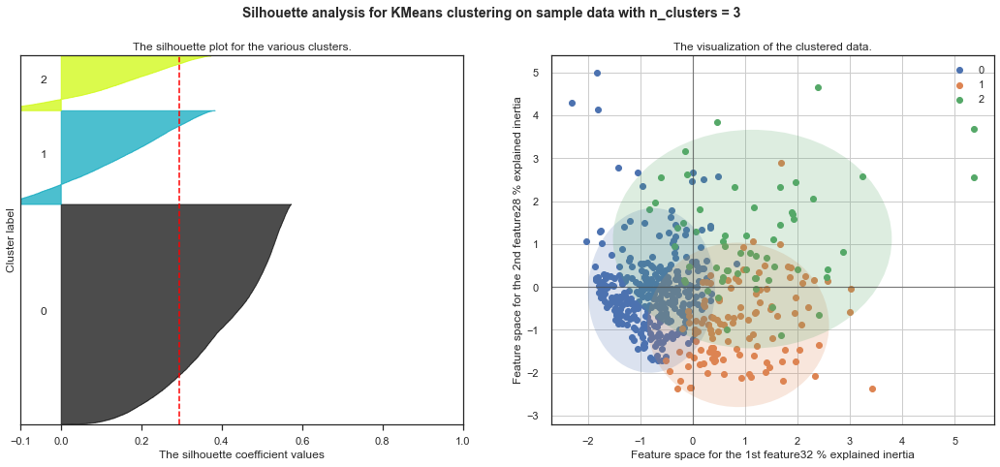

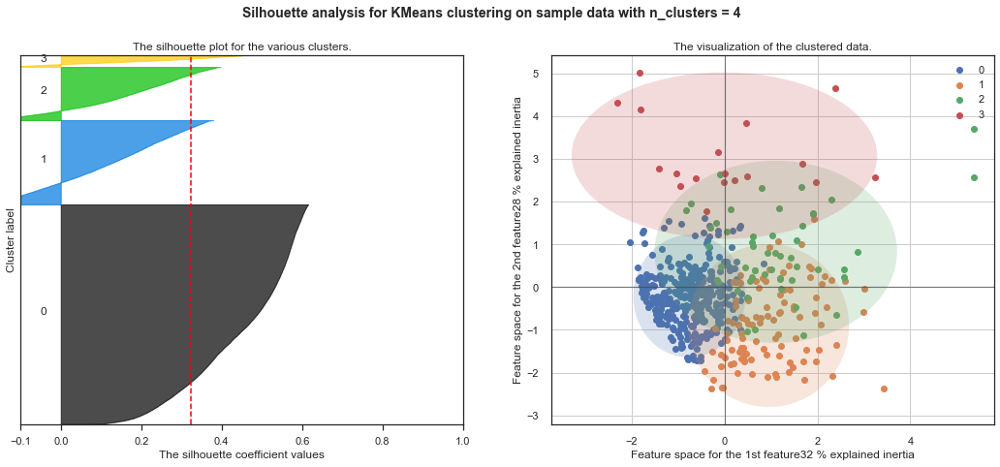

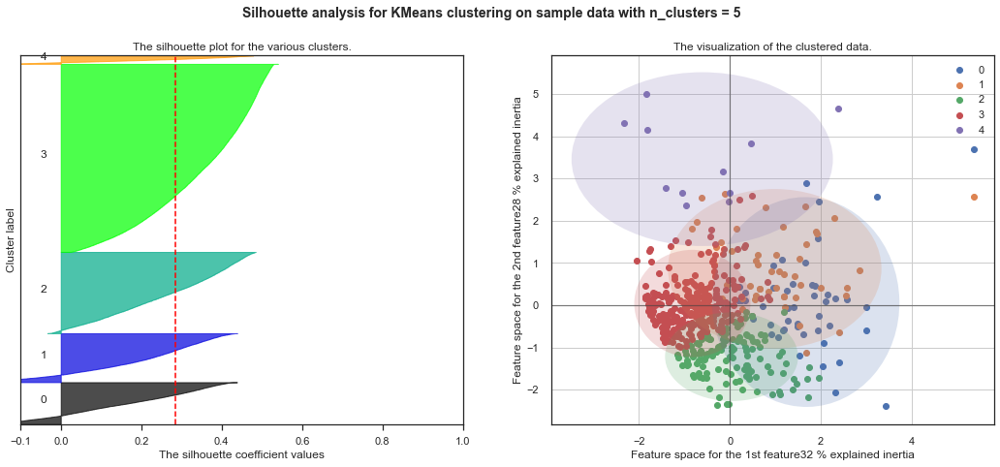

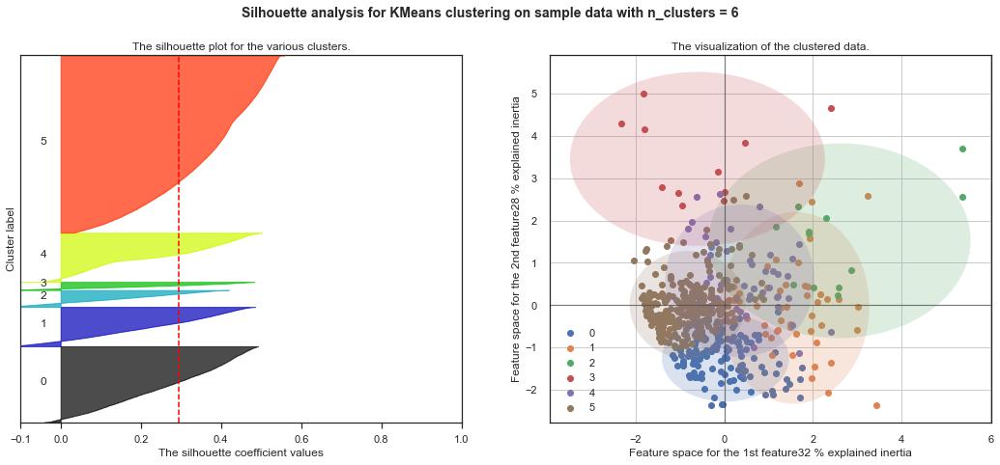

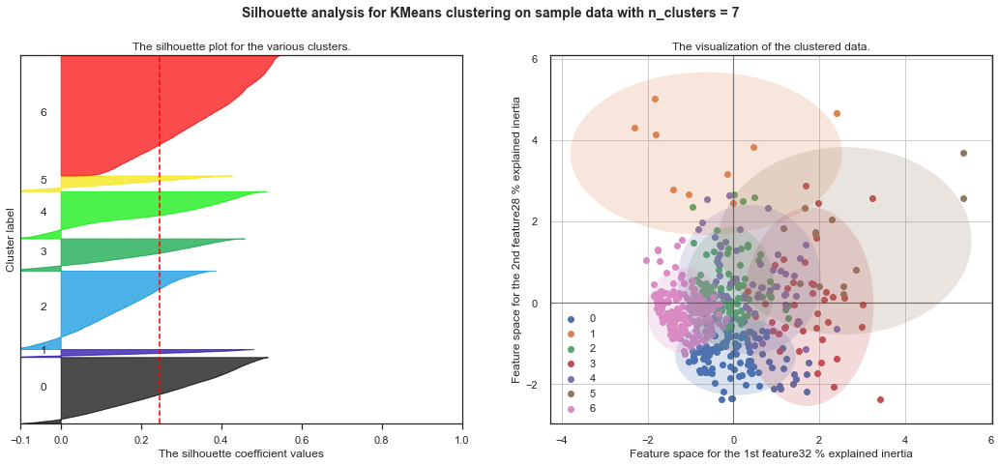

In [285]:
range_n_clusters = [3, 4, 5, 6, 7]
pca = prince.PCA(n_components=2)
pca.fit(test2)
xsample = test2.sample(500, random_state=42)
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(test2) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(test2)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(test2, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(test2, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)

    pca.plot_row_coordinates(xsample, color_labels=clusterer.predict(xsample), ax=ax2)

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel(
        "Feature space for the 1st feature"
        + str(int(pca.explained_inertia_[0] * 100))
        + " % explained inertia"
    )
    ax2.set_ylabel(
        "Feature space for the 2nd feature"
        + str(int(pca.explained_inertia_[1] * 100))
        + " % explained inertia"
    )

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

In [290]:
def display_circles(
    pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None
):
    for (
        d1,
        d2,
    ) in (
        axis_ranks
    ):  # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7, 7))

            # détermination des limites du graphique
            if lims is not None:
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30:
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else:
                xmin, xmax, ymin, ymax = (
                    min(pcs[d1, :]),
                    max(pcs[d1, :]),
                    min(pcs[d2, :]),
                    max(pcs[d2, :]),
                )

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30:
                plt.quiver(
                    np.zeros(pcs.shape[1]),
                    np.zeros(pcs.shape[1]),
                    pcs[d1, :],
                    pcs[d2, :],
                    angles="xy",
                    scale_units="xy",
                    scale=1,
                    color="grey",
                )
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0, 0], [x, y]] for x, y in pcs[[d1, d2]].T]
                ax.add_collection(
                    LineCollection(lines, axes=ax, alpha=0.1, color="black")
                )

            # affichage des noms des variables
            if labels is not None:
                for i, (x, y) in enumerate(pcs[[d1, d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax:
                        plt.text(
                            x,
                            y,
                            labels[i],
                            fontsize="14",
                            ha="center",
                            va="center",
                            rotation=label_rotation,
                            color="blue",
                            alpha=0.5,
                        )

            # affichage du cercle
            circle = plt.Circle((0, 0), 1, facecolor="none", edgecolor="b")
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-1, 1], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title("Cercle des corrélations (F{} et F{})".format(d1 + 1, d2 + 1))
            plt.show(block=False)

In [299]:
pca_ = PCA()
pca_.fit(test2)

PCA()

<BarContainer object of 5 artists>

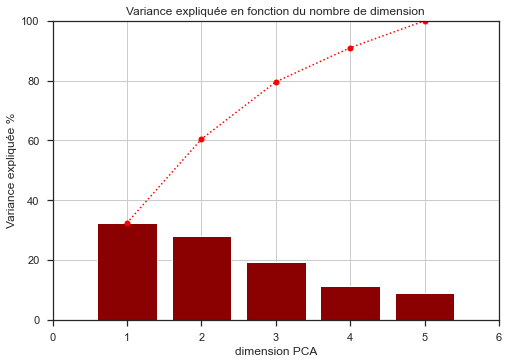

In [301]:
cumsum = np.cumsum(pca_.explained_variance_ratio_)
plt.plot(np.arange(1, len(cumsum) + 1), cumsum * 100, "o:", color="red")
plt.xlim(0, len(cumsum) + 1)
plt.ylim(0, 100)
plt.grid()
plt.xlabel("dimension PCA")
plt.ylabel("Variance expliquée %")
plt.title("Variance expliquée en fonction du nombre de dimension")
plt.bar(
    np.arange(1, len(cumsum) + 1), pca_.explained_variance_ratio_ * 100, color="darkred"
)

In [303]:
pca.explained_inertia_

array([0.32390705, 0.28023219])

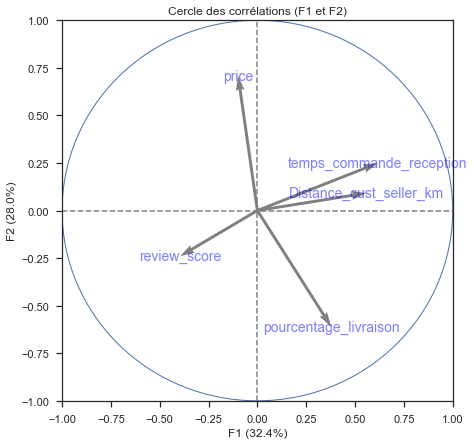

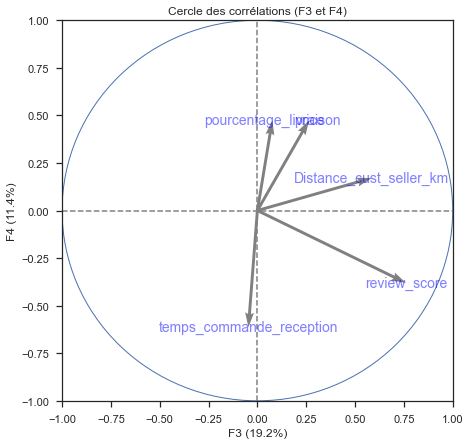

In [302]:
pcs = pca_.components_
display_circles(
    pcs, len(cumsum), pca_, [(0, 1), (2, 3), (4, 5)], labels=df_clust.columns.tolist()
)

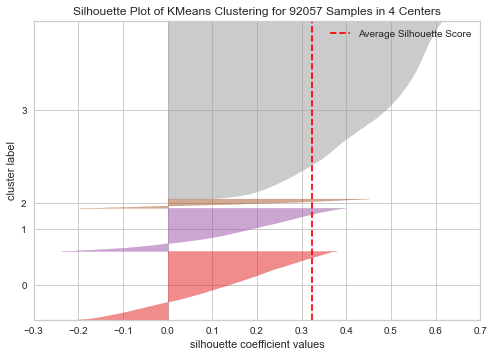

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 92057 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [8]:
model_4 = KMeans(4)


visualizer_4means = SilhouetteVisualizer(model_4)

visualizer_4means.fit(test2)
visualizer_4means.poof()

In [304]:
data_w4means = df_clust.copy()
data_w4means["cluster"] = visualizer_4means.estimator.labels_
data_w4means.groupby("cluster").price.describe()

,count,mean,std,min,25%,50%,75%,max
cluster,,,,,,,,
0,54728.0,119.460084,93.259247,8.99,54.9000,94.0,149.9900,614.9
1,21194.0,73.547960,74.867218,0.85,25.2625,46.9,98.7675,639.0
2,2844.0,995.657309,616.813470,455.00,649.0000,799.9,1120.4250,13440.0
3,13291.0,130.919633,113.497217,3.54,53.9000,99.0,167.6800,899.8


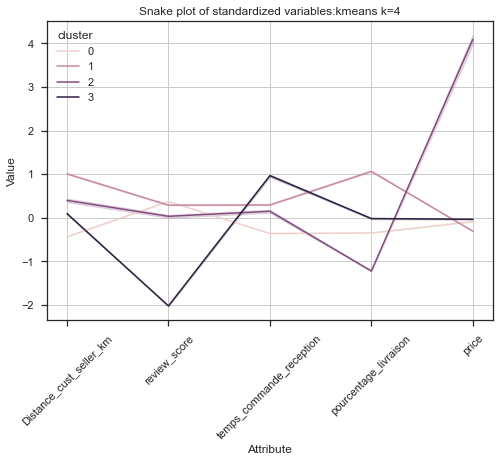

In [401]:
data_clustm4 = test2.copy()
data_clustm4["cluster"] = visualizer_4means.estimator.labels_

data_4_melt = pd.melt(
    data_clustm4.reset_index(),
    id_vars=["customer_unique_id", "cluster"],
    value_vars=[
        "Distance_cust_seller_km",
        "review_score",
        "temps_commande_reception",
        "pourcentage_livraison",
        "price",
    ],
    var_name="Attribute",
    value_name="Value",
)

sns.lineplot(x="Attribute", y="Value", hue="cluster", data=data_4_melt)
plt.title("Snake plot of standardized variables:kmeans k=4")
plt.grid()
plt.xticks(rotation=45)
plt.show()

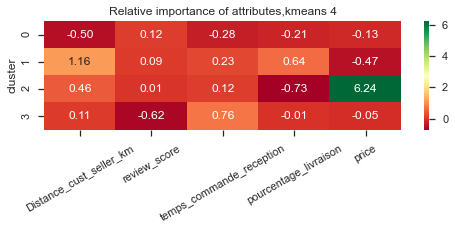

In [407]:
cluster_avg = data_w4means.groupby(["cluster"]).mean()
population_avg = data_w4means.drop("cluster", axis=1).mean()
relative_imp = cluster_avg / population_avg - 1

plt.figure(figsize=(8, 2))
plt.title("Relative importance of attributes,kmeans 4")
plt.xticks(rotation=45)
sns.heatmap(data=relative_imp, annot=True, fmt=".2f", cmap="RdYlGn")
plt.xticks(rotation=30)

plt.show()

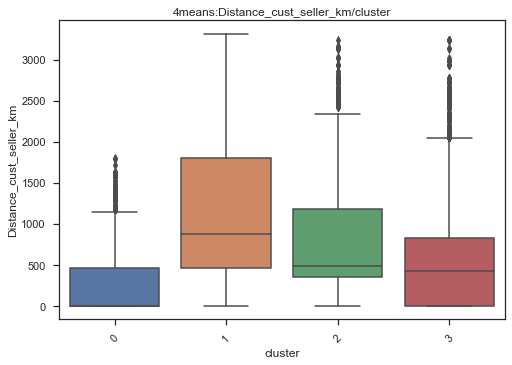

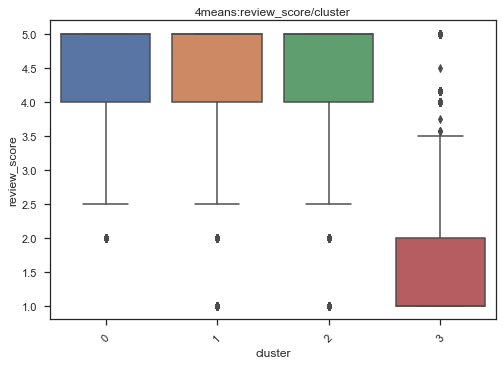

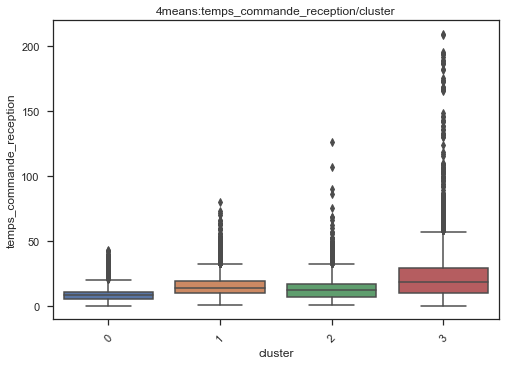

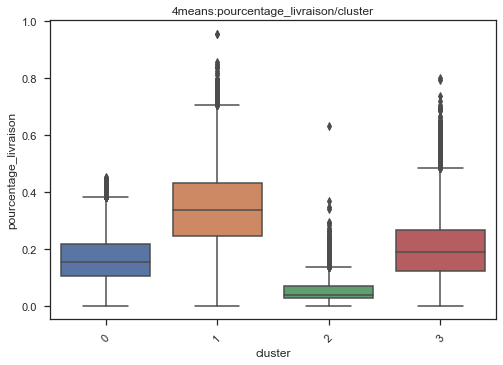

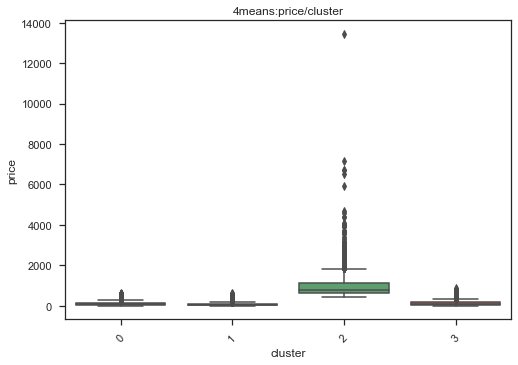

In [305]:
for k in [
    "Distance_cust_seller_km",
    "review_score",
    "temps_commande_reception",
    "pourcentage_livraison",
    "price",
]:
    sns.boxplot(data=data_w4means[[k, "cluster"]], x="cluster", y=k)
    plt.xticks(rotation=45)
    plt.title("4means:" + k + "/cluster")
    plt.show()

In [306]:
df_analyse_4means = pd.DataFrame(
    std_scl.inverse_transform(
        pd.DataFrame(
            visualizer_4means.estimator.cluster_centers_, columns=test2.columns
        )
    ),
    columns=test2.columns,
)

In [312]:
clust4vs6 = pd.DataFrame(
    {
        "6means": visualizer.estimator.labels_,
        "4means": visualizer_4means.estimator.labels_,
    }
)

In [325]:
cm_c = sns.light_palette("green", as_cmap=True)

In [307]:
nb_cust_clust = pd.Series(
    visualizer_4means.estimator.labels_, name="nb_cust_clust"
).value_counts()
df_analyse_4means = pd.merge(
    df_analyse_4means, nb_cust_clust, left_index=True, right_index=True
)
df_analyse_4means.style.bar(subset=df_analyse_4means.columns, color="red")

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price,nb_cust_clust
0,266.086624,4.633977,8.679637,0.165563,119.548500,54728
1,1157.792924,4.526629,14.922509,0.341787,73.518144,21194
2,783.496198,4.199398,13.550176,0.056699,996.237728,2844
3,595.944214,1.580764,21.352489,0.206881,130.871750,13291


In [327]:
df_analyse_cluster.style.bar(subset=df_analyse_cluster.columns, color="red")

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price,nb_cust_clust
0,440.196589,4.595284,10.493310,0.363506,40.106893,19027
1,346.107488,1.957019,11.443915,0.185150,128.699217,12321
2,1869.395254,4.402157,17.594614,0.264525,132.666114,9862
3,288.223411,4.754399,9.068330,0.142554,136.196032,44570
4,719.134163,4.152177,12.826932,0.053172,1145.078929,2059
5,920.270547,1.679369,40.088984,0.227106,138.207590,4218


la classe 3 est celle qui note le mieux, qui à reçu le plus rapidement en terme de délais de livraison, qui a payé de livraison peu proportionellement au prix total et à fait une dépense moyenne. C'est le cluster comptant le plus de client.

La classe 1 est la classe avec des reviews plûtot mauvais, qui n'a pas particulièrement attendu et payé la normale en terme de % pour la livraison. Elle a acheté pour un prix classique et est composé de 15% des clients

la classe 0 a donnée un bon review pourtant a payé en moyenne le plus de livraison pour un distance moyenne et une durée raisonnable. c'est un cluster qui dépense également le moins en moyenne 

la classe 2 est celle qui est plûtot satisfaite avec les clients patients dont la distance seller/cust est la plus grande. C'est un prix raisonnable de livraison et de dépense total moyen. Cluster de taille moyenne

La classe 4 est une classe interessante car elle correspond aux client satisfaits qui dépense le plus et qui ne sont pas exigeant sur le temps. elle dépense égalmeent le moins proportionnellement en pourcentage de livraison. Ce cluster est cependant le plus faible en terme de clients

La classe 5 est une classe qui donne de mauvaise note et on peut supposer cela par rapport au temps d'attente et à la distance entre sellet/cust. elle dépense la moyenne et donne 20% dans la livraison. 


On peut réunir la catégorie 1 et 5 qui sont des clients déçus soit par la livraison soit par la qualité des produits. 

Les clients de 0, 2,3,4 sont plûtot satisfait soit par leur produit soit par la rapidité donc des idéées viennent pour les maintenir ainsi.


In [326]:
(pd.crosstab(clust4vs6["6means"], clust4vs6["4means"])).style.background_gradient(
    cmap=cm_c
).highlight_null("red").highlight_min(axis=0, color="red").highlight_max(
    axis=0, color="blue"
)

4means,0,1,2,3
6means,,,,
0,7593,11267,0,167
1,3477,108,68,8668
2,262,8931,224,445
3,43387,667,451,65
4,0,0,2059,0
5,9,221,42,3946


c vaut 184893.62038504012 
 avec 15 deg de liberté 
 et pvalue de 0.0


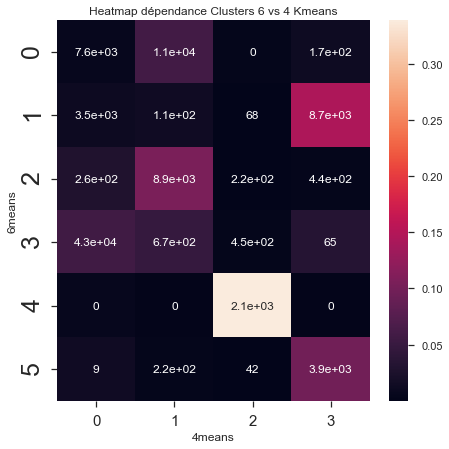

In [318]:
X = "6means"
Y = "4means"

cont = clust4vs6.pivot_table(
    index=X, columns=Y, aggfunc=len, margins=True, margins_name="Total"
)

c, p, dof, expected = chi2_contingency(cont.iloc[:-1, :-1].fillna(0), correction=False)
print("c vaut", c, "\n avec", dof, "deg de liberté \n et pvalue de", p)
tx = cont.loc[:, ["Total"]]
ty = cont.loc[["Total"], :]
n = len(clust4vs6)
indep = tx.dot(ty) / n

measure = (cont.fillna(0) - indep) ** 2 / indep
xi_n = measure.sum().sum()
table = measure / xi_n
plt.figure(figsize=(7, 7))
plt.xticks(fontsize=15)
plt.yticks(fontsize=25)

ax = sns.heatmap(table.iloc[:-1, :-1], annot=cont.fillna(0).iloc[:-1, :-1])
ax.set_title("Heatmap dépendance Clusters 6 vs 4 Kmeans")
plt.show()

<font color='red'> On choisit finalement le clustering 4 qui est un résumé du clustering à 6. On part de l'hypothèse que c'est une proposition faite à l'équipe marketing et finalement on pourrait reévaluer nos modèles selon leurs exigences
    
    
Petite représentation avec t-sne pour voir si quelque chose est visible grâce à cet algorithme de réducction de dimension

In [329]:
tsne = manifold.TSNE(n_components=2, init="pca")
X_trans = tsne.fit_transform(test2)

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

C:\Users\miche\anaconda3\envs\tf\lib\site-packages\sklearn\manifold\_t_sne.py:982: FutureWarning:

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.



In [345]:
tsne.

array([ 15.727858, -21.514744,  24.217386, ..., -21.542734, -14.232813,
       -21.175434], dtype=float32)

In [354]:
plt.cm.Set2(visualizer_4means.estimator.labels_[int(5)] / 10.0)

(0.4, 0.7607843137254902, 0.6470588235294118, 1.0)

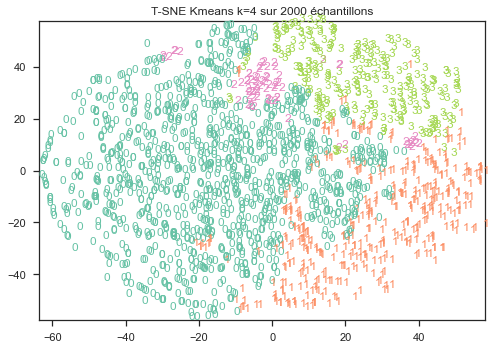

In [365]:
plt.figure()
for i in np.linspace(0, test2.shape[0] - 1, 2000):
    plt.text(
        X_trans[int(i), 0],
        X_trans[int(i), 1],
        str("%d" % visualizer_4means.estimator.labels_[int(i)]),
        color=plt.cm.Set2(visualizer_4means.estimator.labels_[int(i)] / 5.0),
    )
plt.xlim([np.min(X_trans[:, 0]), np.max(X_trans[:, 0])])
plt.ylim([np.min(X_trans[:, 1]), np.max(X_trans[:, 1])])
plt.title("T-SNE Kmeans k=4 sur 2000 échantillons")
plt.show()

### <font color='red'> Recherche des hyperpramètres optimisant le kmeans et choix entre 4 et 6 clusters

In [7]:
test2.head()

,Distance_cust_seller_km,review_score,temps_commande_reception,pourcentage_livraison,price
customer_unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,-0.867025,0.663005,-0.638876,-0.995748,-0.036788
0000b849f77a49e4a4ce2b2a4ca5be3f,-0.867025,-0.121643,-0.953117,0.770019,-0.566183
0000f46a3911fa3c0805444483337064,-0.026239,-0.906292,1.351319,-0.072852,-0.327240
0000f6ccb0745a6a4b88665a16c9f078,2.852936,-0.121643,0.827583,1.565693,-0.532369
0004aac84e0df4da2b147fca70cf8255,-0.867025,0.663005,0.094354,-0.985991,0.202155


On a pris pour les derniers modèles (6 et 4) les hyperparamètres donnés par scikit-learn, soit : 

        -n_init = 10
        -max_iter = 300
        -tol = 10e-4
Je propose de regarder la métrique suivante pour comparer les modèles avec 4 et 6 clusters:

        - silouhette score 
On va également faire une comparaison de la prédiction obtenue par rapport au modèle choisi qui est le kmeans=4 avec les paramètres cités ci-dessus

In [25]:
from sklearn.metrics.cluster import adjusted_rand_score

In [9]:
model_init=visualizer_4means.estimator

In [15]:
model_init.inertia_

257599.4350373742

In [32]:
df_res=pd.DataFrame(columns=['silhouette_score','inertia_','ARI'])

In [47]:
df_res=df_res.append(pd.DataFrame([[silhouette_score(X=test2,labels=model_init.labels_),
                             model_init.inertia_,
                             adjusted_rand_score(model_init.labels_,model_init.labels_)]],
             columns=['silhouette_score','inertia_','ARI'],
             index=['model_init']))

C:\Users\miche\AppData\Local\Temp\ipykernel_63596\1088026337.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_res=df_res.append(pd.DataFrame([[silhouette_score(X=test2,labels=model_init.labels_),


In [49]:
df_res

,silhouette_score,inertia_,ARI
model_init,0.322702,257599.435037,1.0


In [46]:
list_k=[4,6]
list_n_init=[5,10,20]
list_max_iter=[100,300,600]


In [57]:
for n_clusters in list_k:
    for n_init in list_n_init:
        for max_iter in list_max_iter:
            model=KMeans(n_clusters=n_clusters,n_init=n_init,max_iter=max_iter,random_state=42)
            model.fit(test2) 
            df_res=df_res.append(pd.DataFrame([[silhouette_score(X=test2,labels=model.labels_),
                             model.inertia_,
                             adjusted_rand_score(model_init.labels_,model.labels_)]],
             columns=['silhouette_score','inertia_','ARI'],
             index=['model_k'+str(n_clusters)+'_n_init'+str(n_init)+'_max_iter'+str(max_iter)]))

C:\Users\miche\AppData\Local\Temp\ipykernel_63596\3888633540.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_res=df_res.append(pd.DataFrame([[silhouette_score(X=test2,labels=model.labels_),
C:\Users\miche\AppData\Local\Temp\ipykernel_63596\3888633540.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_res=df_res.append(pd.DataFrame([[silhouette_score(X=test2,labels=model.labels_),
C:\Users\miche\AppData\Local\Temp\ipykernel_63596\3888633540.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_res=df_res.append(pd.DataFrame([[silhouette_score(X=test2,labels=model.labels_),
C:\Users\miche\AppData\Local\Temp\ipykernel_63596\3888633540.py:6: FutureWarning: The frame.append method is deprecated and will be removed fr

In [59]:
df_res.sort_values(by='silhouette_score',ascending=False)

,silhouette_score,inertia_,ARI
model_k4_n_init20_max_iter600,0.323826,257598.396842,0.992043
model_k4_n_init20_max_iter100,0.323826,257599.435037,0.992043
model_k4_n_init20_max_iter100,0.323826,257598.396842,0.992043
model_k4_n_init20_max_iter300,0.323826,257598.396842,0.992043
model_k4_n_init10_max_iter600,0.323067,257598.788366,0.997597
model_k4_n_init5_max_iter300,0.323067,257599.435037,0.997597
model_k4_n_init5_max_iter600,0.323067,257599.435037,0.997597
model_k4_n_init10_max_iter100,0.323067,257599.435037,0.997597
model_k4_n_init10_max_iter300,0.323067,257599.435037,0.997597
model_k4_n_init10_max_iter600,0.323067,257599.435037,0.997597


On voit que le score ARI est très proche de 1 et que la différence d'inertie est très faible. On peut conclure que l'hyperparamètrage des différents modèles de change pas grand chose. 

## Première approche brouillon 

In [4]:
date_max = df_.order_purchase_timestamp.max()
df = df_.groupby("customer_unique_id").agg(
    {
        "price": "mean",
        "pourcentage_livraison": "mean",
        "temps_commande_reception": "mean",
        "review_score": "mean",
        "cat_creneautravailoupas": lambda x: x.value_counts().index[0],
        "Distance_cust_seller_km": "mean",
        "cat_mode_order": lambda x: x.value_counts().index[0],
        "total_weight_order": "mean",
        "nb_article": "mean",
        "customer_state": lambda x: x.value_counts().index[0],
        "order_purchase_timestamp": lambda x: (date_max - x.max()).days,
    }
)

In [12]:
df.rename(
    {
        "price": "prix_moyen",
        "pourcentage_livraison": "pourcentage_moyen_livraison",
        "temps_commande_reception": "temps_moyen_livraison",
        "review_score": "review_moyen",
        "cat_creneautravailoupas": "Pendant_travail_perso",
        "Distance_cust_seller_km": "distance_moyenne_livr",
        "cat_mode_order": "catégorie_principale_achat",
        "total_weight_order": "poids_moyen_commande",
        "nb_article": "nb_article_moyen",
        "customer_state": "région",
        "order_purchase_timestamp": "durée_dernier_achat",
    },
    axis=1,
    inplace=True,
)

In [13]:
df

,prix_moyen,pourcentage_moyen_livraison,temps_moyen_livraison,review_moyen,Pendant_travail_perso,distance_moyenne_livr,catégorie_principale_achat,poids_moyen_commande,nb_article_moyen,région,durée_dernier_achat
customer_unique_id,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.90,0.084567,6.0,5.0,temps_prof,0.000000,maison,1500.0,1.0,Est,111
0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,0.304892,3.0,4.0,temps_prof,0.000000,consommable,375.0,1.0,Est,114
0000f46a3911fa3c0805444483337064,69.00,0.199722,25.0,3.0,temps_perso,519.122328,multimedia,1500.0,1.0,Sud,536
0000f6ccb0745a6a4b88665a16c9f078,25.99,0.404172,20.0,4.0,temps_perso,2296.795588,multimedia,150.0,1.0,Nord_Ouest,320
0004aac84e0df4da2b147fca70cf8255,180.00,0.085784,13.0,5.0,temps_perso,0.000000,multimedia,6050.0,1.0,Est,287
...,...,...,...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,1570.00,0.240599,27.0,5.0,temps_perso,2057.337784,consommable,60000.0,2.0,Nord_Est,446
fffea47cd6d3cc0a88bd621562a9d061,64.89,0.232797,30.0,4.0,temps_perso,1375.789636,consommable,1720.0,1.0,Nord_Est,261
ffff371b4d645b6ecea244b27531430a,89.90,0.200605,14.0,5.0,temps_prof,1356.978712,service_outils,600.0,1.0,Ouest,567


In [14]:
df.describe()

,prix_moyen,pourcentage_moyen_livraison,temps_moyen_livraison,review_moyen,distance_moyenne_livr,poids_moyen_commande,nb_article_moyen,durée_dernier_achat
count,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000
mean,137.613535,0.208812,12.099224,4.155029,535.322717,2395.511078,1.140116,236.222145
std,209.674393,0.124776,9.546858,1.274463,617.427850,4761.145558,0.528556,152.545896
min,0.850000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,46.400000,0.117290,6.000000,4.000000,0.000000,300.000000,1.000000,113.000000
50%,86.970000,0.183577,10.000000,5.000000,426.472203,750.000000,1.000000,217.000000
75%,149.900000,0.274926,15.000000,5.000000,818.267566,2100.000000,1.000000,345.000000
max,13440.000000,0.955451,209.000000,5.000000,3310.827734,184400.000000,21.000000,713.000000


Sans scaling (sur un malentendu)

In [69]:
X = df[df.describe().columns]

In [16]:
X.shape

(92057, 8)

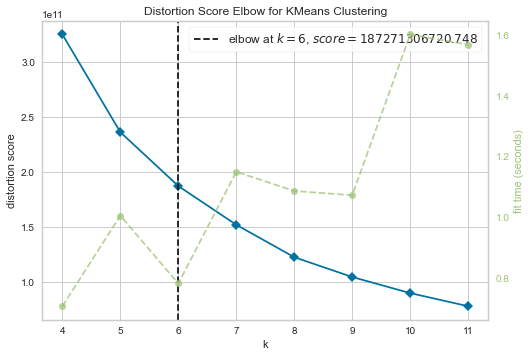

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [17]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 12))

visualizer.fit(X)
visualizer.poof()

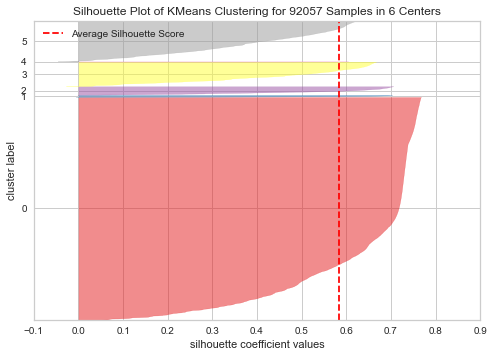

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 92057 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [48]:
model = KMeans(6)

visualizer = SilhouetteVisualizer(model)

visualizer.fit(X)
visualizer.poof()

In [50]:
pd.Series(visualizer.estimator.labels_).value_counts()

0    68629
5    12479
3     7583
2     2594
1      695
4       77
dtype: int64

In [70]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [55]:
pd.DataFrame(X_scaled, columns=X.columns).describe()

,prix_moyen,pourcentage_moyen_livraison,temps_moyen_livraison,review_moyen,distance_moyenne_livr,poids_moyen_commande,nb_article_moyen,durée_dernier_achat
count,9.205700e+04,9.205700e+04,9.205700e+04,9.205700e+04,9.205700e+04,9.205700e+04,9.205700e+04,9.205700e+04
mean,5.950548e-17,4.275081e-17,4.460695e-17,1.437403e-16,5.511552e-16,-9.319635e-16,2.118827e-15,-1.026803e-17
std,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00,1.000005e+00
min,-6.522698e-01,-1.673496e+00,-1.267358e+00,-2.475589e+00,-8.670254e-01,-5.031403e-01,-2.650933e-01,-1.548540e+00
25%,-4.350270e-01,-7.334861e-01,-6.388759e-01,-1.216433e-01,-8.670254e-01,-4.401299e-01,-2.650933e-01,-8.077754e-01
50%,-2.415355e-01,-2.022402e-01,-2.198876e-01,6.630051e-01,-1.762977e-01,-3.456143e-01,-2.650933e-01,-1.260096e-01
75%,5.859815e-02,5.298609e-01,3.038478e-01,6.630051e-01,4.582663e-01,-6.206756e-02,-2.650933e-01,7.130867e-01
max,6.344341e+01,5.983845e+00,2.062478e+01,6.630051e-01,4.495295e+00,3.822724e+01,3.757408e+01,3.125489e+00


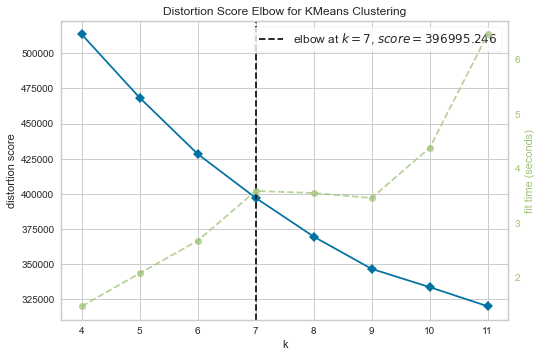

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [56]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 12))

visualizer.fit(X_scaled)
visualizer.poof()

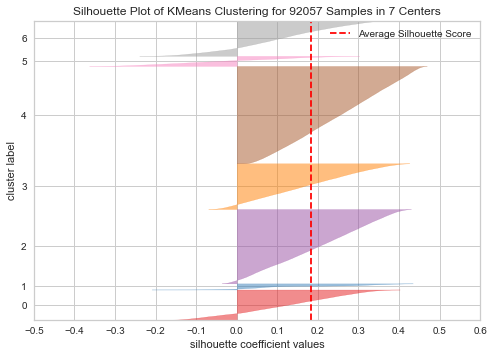

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 92057 Samples in 7 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [57]:
model = KMeans(7)

visualizer = SilhouetteVisualizer(model)

visualizer.fit(X_scaled)
visualizer.poof()

In [91]:
from sklearn import metrics

metrics.silhouette_score(X_scaled, visualizer.estimator.labels_)

0.1824035559895092

In [58]:
pd.Series(visualizer.estimator.labels_).value_counts()

4    29984
2    22899
3    14085
6    10783
0     9327
5     3100
1     1879
dtype: int64

In [79]:
X_withcluster = X.copy()
X_withcluster["cluster"] = visualizer.estimator.labels_

In [94]:
X_withcluster_scaled = pd.DataFrame(X_scaled, columns=X.columns)
X_withcluster_scaled["cluster"] = visualizer.estimator.labels_

In [92]:
X_withcluster.sample(n=500).cluster.value_counts()

4    174
2    131
3     69
6     48
0     48
5     19
1     11
Name: cluster, dtype: int64

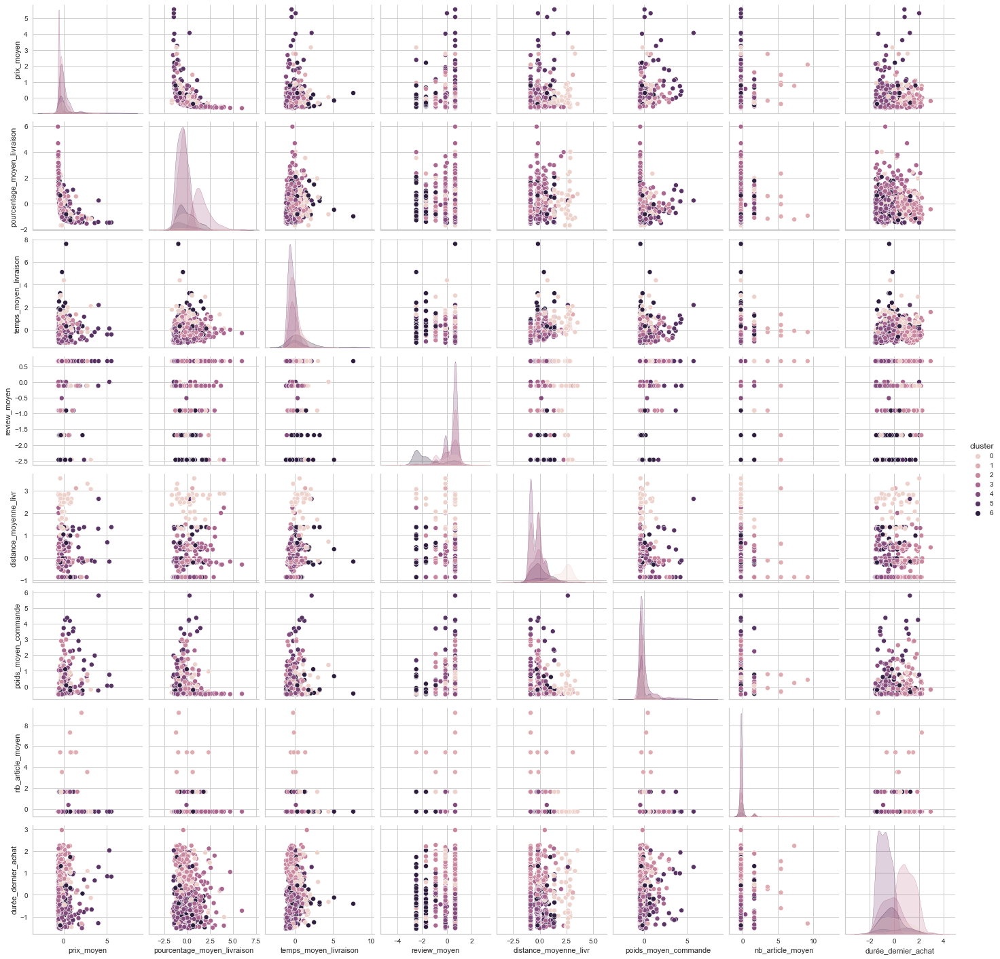

In [96]:
sns.pairplot(X_withcluster_scaled.sample(n=500), hue="cluster")

0        4
1        3
2        2
3        0
4        2
        ..
92052    5
92053    0
92054    2
92055    4
92056    2
Name: cluster, Length: 92057, dtype: int32

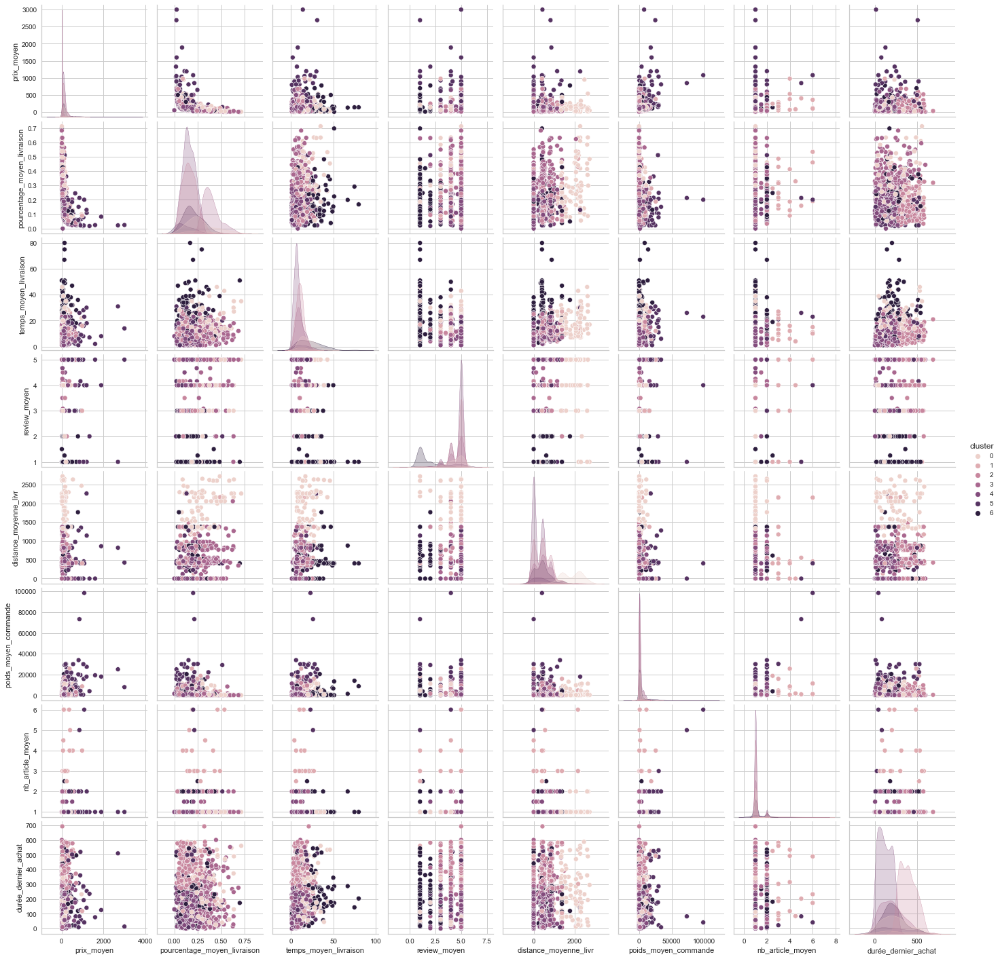

In [83]:
sns.pairplot(X_withcluster.sample(n=1000), hue="cluster", diag_kind="hist")

In [72]:
center = pd.DataFrame(visualizer.estimator.cluster_centers_)

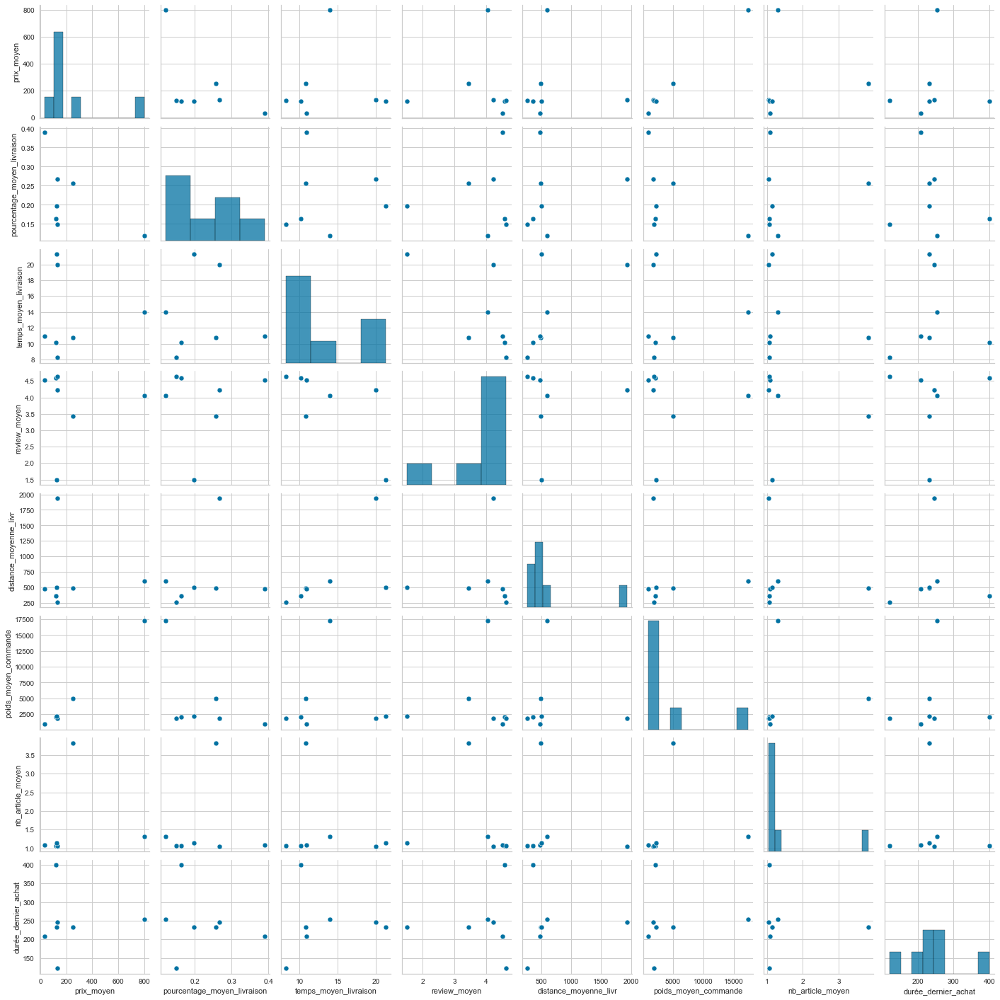

In [78]:
sns.pairplot(pd.DataFrame(scaler.inverse_transform(center), columns=X.columns))

In [76]:
X.describe()

,prix_moyen,pourcentage_moyen_livraison,temps_moyen_livraison,review_moyen,distance_moyenne_livr,poids_moyen_commande,nb_article_moyen,durée_dernier_achat
count,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000,92057.000000
mean,137.613535,0.208812,12.099224,4.155029,535.322717,2395.511078,1.140116,236.222145
std,209.674393,0.124776,9.546858,1.274463,617.427850,4761.145558,0.528556,152.545896
min,0.850000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,46.400000,0.117290,6.000000,4.000000,0.000000,300.000000,1.000000,113.000000
50%,86.970000,0.183577,10.000000,5.000000,426.472203,750.000000,1.000000,217.000000
75%,149.900000,0.274926,15.000000,5.000000,818.267566,2100.000000,1.000000,345.000000
max,13440.000000,0.955451,209.000000,5.000000,3310.827734,184400.000000,21.000000,713.000000


In [106]:
from sklearn.decomposition import PCA

In [107]:
pca = PCA()

In [108]:
X_pca = pca.fit_transform(X_scaled)

In [109]:
X_pca.shape

(92057, 8)

In [115]:
np.cumsum(pca.explained_variance_ratio_)

array([0.20923211, 0.4127791 , 0.55264438, 0.67657728, 0.79623667,
       0.88453526, 0.94918745, 1.        ])

In [117]:
df.columns.tolist()

['prix_moyen',
 'pourcentage_moyen_livraison',
 'temps_moyen_livraison',
 'review_moyen',
 'Pendant_travail_perso',
 'distance_moyenne_livr',
 'catégorie_principale_achat',
 'poids_moyen_commande',
 'nb_article_moyen',
 'région',
 'durée_dernier_achat']

In [122]:
X

,prix_moyen,pourcentage_moyen_livraison,temps_moyen_livraison,review_moyen,distance_moyenne_livr,poids_moyen_commande,nb_article_moyen,durée_dernier_achat
customer_unique_id,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.90,0.084567,6.0,5.0,0.000000,1500.0,1.0,111
0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,0.304892,3.0,4.0,0.000000,375.0,1.0,114
0000f46a3911fa3c0805444483337064,69.00,0.199722,25.0,3.0,519.122328,1500.0,1.0,536
0000f6ccb0745a6a4b88665a16c9f078,25.99,0.404172,20.0,4.0,2296.795588,150.0,1.0,320
0004aac84e0df4da2b147fca70cf8255,180.00,0.085784,13.0,5.0,0.000000,6050.0,1.0,287
...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,1570.00,0.240599,27.0,5.0,2057.337784,60000.0,2.0,446
fffea47cd6d3cc0a88bd621562a9d061,64.89,0.232797,30.0,4.0,1375.789636,1720.0,1.0,261
ffff371b4d645b6ecea244b27531430a,89.90,0.200605,14.0,5.0,1356.978712,600.0,1.0,567


In [119]:
def display_factorial_planes(
    X_projected, n_comp, pca, axis_ranks, labels=None, alpha=1, illustrative_var=None
):
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            fig = plt.figure(figsize=(7, 6))

            # affichage des points
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1], X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(
                        X_projected[selected, d1],
                        X_projected[selected, d2],
                        alpha=alpha,
                        label=value,
                    )
                plt.legend()

            # affichage des labels des points
            if labels is not None:
                for i, (x, y) in enumerate(X_projected[:, [d1, d2]]):
                    plt.text(x, y, labels[i], fontsize="14", ha="center", va="center")

            # détermination des limites du graphique
            boundary = np.max(np.abs(X_projected[:, [d1, d2]])) * 1.1
            plt.xlim([-boundary, boundary])
            plt.ylim([-boundary, boundary])

            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-100, 100], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title(
                "Projection des individus (sur F{} et F{})".format(d1 + 1, d2 + 1)
            )
            plt.show(block=False)


def display_circles(
    pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None
):
    for (
        d1,
        d2,
    ) in (
        axis_ranks
    ):  # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7, 7))

            # détermination des limites du graphique
            if lims is not None:
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30:
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else:
                xmin, xmax, ymin, ymax = (
                    min(pcs[d1, :]),
                    max(pcs[d1, :]),
                    min(pcs[d2, :]),
                    max(pcs[d2, :]),
                )

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30:
                plt.quiver(
                    np.zeros(pcs.shape[1]),
                    np.zeros(pcs.shape[1]),
                    pcs[d1, :],
                    pcs[d2, :],
                    angles="xy",
                    scale_units="xy",
                    scale=1,
                    color="grey",
                )
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0, 0], [x, y]] for x, y in pcs[[d1, d2]].T]
                ax.add_collection(
                    LineCollection(lines, axes=ax, alpha=0.1, color="black")
                )

            # affichage des noms des variables
            if labels is not None:
                for i, (x, y) in enumerate(pcs[[d1, d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax:
                        plt.text(
                            x,
                            y,
                            labels[i],
                            fontsize="14",
                            ha="center",
                            va="center",
                            rotation=label_rotation,
                            color="blue",
                            alpha=0.5,
                        )

            # affichage du cercle
            circle = plt.Circle((0, 0), 1, facecolor="none", edgecolor="b")
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color="grey", ls="--")
            plt.plot([0, 0], [-1, 1], color="grey", ls="--")

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel(
                "F{} ({}%)".format(
                    d1 + 1, round(100 * pca.explained_variance_ratio_[d1], 1)
                )
            )
            plt.ylabel(
                "F{} ({}%)".format(
                    d2 + 1, round(100 * pca.explained_variance_ratio_[d2], 1)
                )
            )

            plt.title("Cercle des corrélations (F{} et F{})".format(d1 + 1, d2 + 1))
            plt.show(block=False)

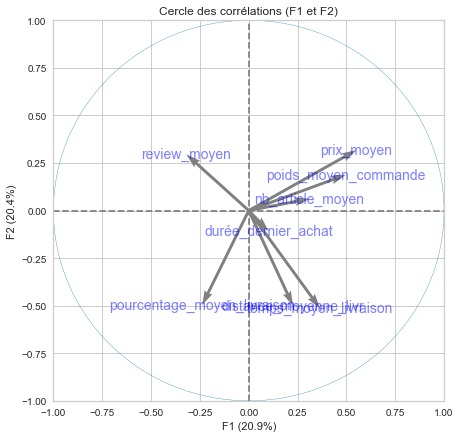

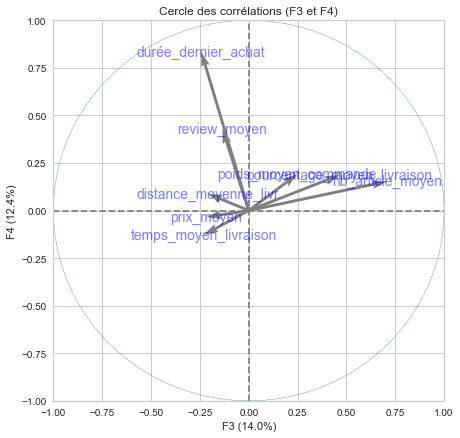

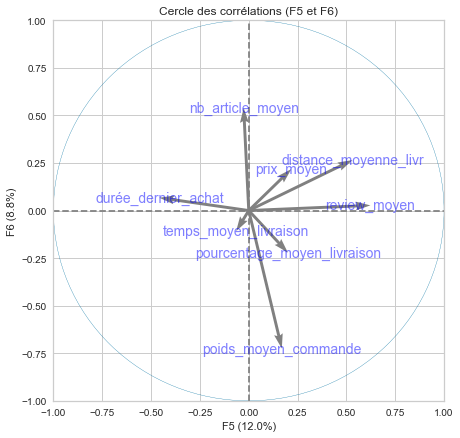

In [123]:
display_circles(
    pca.components_,
    len(np.cumsum(pca.explained_variance_ratio_)),
    pca,
    [(0, 1), (2, 3), (4, 5)],
    labels=X.columns.tolist(),
)

In [124]:
pca_data = pd.DataFrame(X_pca)
pca_data["cluster"] = visualizer.estimator.labels_

In [126]:
pca_data.head()

,0,1,2,3,4,5,6,7,cluster
0,-0.682331,1.477814,-0.249698,-0.656633,0.136712,0.007787,-0.421516,-0.179978,4
1,-1.374631,0.315435,0.801211,-0.634708,-0.142091,-0.312747,0.468836,0.330254,3
2,0.634918,-1.278968,-0.858433,0.995437,-1.675075,-0.107055,-0.357792,0.126651,2
3,0.059141,-3.000377,-0.368731,0.733648,1.259258,0.437477,0.721778,-0.435937,0
4,0.304304,1.227424,-0.509027,0.388525,-0.222433,-0.637096,-0.716675,-0.072626,2


In [131]:
samplepca = pca_data.sample(500).reset_index(drop=True)
samplepca.cluster.value_counts()

4    176
2    106
3     80
6     56
0     50
5     19
1     13
Name: cluster, dtype: int64

In [141]:
scal_test = StandardScaler().fit_transform(
    pd.DataFrame({(1, 1), (3, 1), (1, 2), (2, 0)}, columns=["x", "y"])
)

test_pca = PCA().fit(scal_test)

In [142]:
test_pca.components_

array([[-0.70710678,  0.70710678],
       [ 0.70710678,  0.70710678]])

In [132]:
samplepca.iloc[:, :-1]

,0,1,2,3,4,5,6,7
0,-0.247082,0.484840,-0.527017,-0.247570,0.309168,0.020831,-0.651493,-0.118852
1,0.209252,-0.409354,-0.216629,-1.144422,1.195435,0.032559,0.230795,-0.995857
2,-1.020604,-0.043685,-0.064388,0.865640,-0.044382,0.000259,0.051738,0.183928
3,0.277081,1.320453,-0.953768,1.644981,-1.637318,0.117388,0.488933,-0.174791
4,0.138519,-0.124321,1.510011,0.635305,-0.975463,1.023450,0.635923,-0.225248
...,...,...,...,...,...,...,...,...
495,0.883396,1.920903,-1.353296,0.131147,0.316822,0.856663,0.366432,0.752843
496,-1.096294,0.280662,0.168269,-0.417762,0.651642,0.005306,-0.061350,-0.015399
497,0.848535,-1.857718,-0.552652,-1.121362,-0.858955,0.126758,-0.172180,-0.097676
498,0.621745,-1.266037,2.879818,-1.349718,-0.751163,0.028305,1.136924,0.440759


In [133]:
display_factorial_planes(
    samplepca.iloc[:, :-1],
    len(np.cumsum(pca.explained_variance_ratio_)),
    pca,
    [(0, 1), (2, 3), (4, 5)],
    alpha=0.3,
    illustrative_var=samplepca.cluster,
)

InvalidIndexError: ((array([  5,  17,  19,  31,  40,  43,  61,  77,  81,  95, 100, 101, 105,
       106, 112, 123, 130, 146, 147, 171, 179, 190, 212, 216, 217, 228,
       264, 285, 286, 292, 296, 298, 301, 305, 319, 326, 327, 343, 351,
       360, 363, 366, 372, 384, 395, 415, 430, 458, 487, 499], dtype=int64),), 0)

<Figure size 504x432 with 0 Axes>

In [67]:
visualizer.estimator.cluster_centers_.shape

(7, 8)

In [68]:
X.shape

(92057, 9)

In [19]:
from sklearn.cluster import DBSCAN

In [84]:
db = DBSCAN(eps=0.3, min_samples=8)
db.fit(X)

DBSCAN(eps=0.3, min_samples=8)

In [85]:
pd.DataFrame(db.labels_)[0].value_counts()

-1    92057
Name: 0, dtype: int64

In [88]:
db_scaled = DBSCAN(eps=0.3, min_samples=20)
db_scaled.fit(X_scaled)

DBSCAN(eps=0.3, min_samples=20)

In [90]:
pd.DataFrame(db_scaled.labels_)[0].value_counts()

-1     57508
 2     14199
 0     14121
 1      3265
 3      1936
 4       377
 10       79
 14       56
 18       48
 7        44
 6        41
 5        37
 20       30
 13       30
 16       27
 19       24
 26       21
 15       21
 24       21
 21       20
 25       20
 11       20
 17       20
 23       20
 9        20
 8        19
 12       19
 22       14
Name: 0, dtype: int64